<a href="https://colab.research.google.com/github/acse-moj20/msc-irp/blob/dev/PredGAN/PredGAN_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Dev Code (PredGAN) For Fluid Problem** 

General Specs:
- POD Coefficients: 292
- GAN Architecture 
  - generator: Modified. Additional conv2dT layer and filter size.
  - disciriminator: Modified. 2 additional conv2d layers. 
- Learning_rate: 1e-4
- number generated: 5
- Batch_size: 256
- Epochs: 50,000

**Version: A300**
- Latent space: 300
- ntimes: 21; steps: 1

**Version: B300** (HERE)
- Latent space: 300
- ntimes: 21; steps: 2



Setup and package import

In [1]:
%matplotlib inline
import sys
import os
import sklearn
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import joblib
import time
import functools


mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

In [2]:
from google.colab import drive
drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


# Processing Power and Available Memory

GPU Specs

In [3]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('GPU info not found.')
else:
  print(gpu_info)

print('Num of available GPUs: ', len(tf.config.list_physical_devices('GPU')))

Sun Aug  8 21:12:47 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.42.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-SXM2...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   35C    P0    28W / 300W |      0MiB / 16160MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

Memory Allocation

In [4]:
from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('You are using a high-RAM runtime!')

Your runtime has 27.3 gigabytes of available RAM



#Utility Functions

In [5]:
## UTILITY FUNCTIONS FOR VISUALIZATION AND ERROR MEASUREMENT

def calculate_error(data, data_recovered):
  abs_error = abs(data - data_recovered)
  perc_error = abs_error*100/abs(data)

  return np.max(abs_error), np.mean(abs_error)

def plot_vortex(data, times, cols, rows=1):
  fig, ax = plt.subplots(rows, cols, figsize=[20, 5*cols])
  
  for i, step in enumerate(times):
    im = ax.flatten()[i].imshow(data[step], cmap='RdBu')
    cbar = plt.colorbar(im, ax=ax.flatten()[i], shrink=0.25, pad=0.05, panchor=(0.0, 0.0))    
    ax.flatten()[i].set_title('t = {}'.format(step), y=1.05, 
                          fontsize=16, fontweight="bold")
  plt.show()


def concat_timesteps(X_train, ntimes, step, window_start, window_end):
    X_train_concat = []
    for start, end in zip(window_start, window_end):
      for i in range(start, end+step): 
        X_train_concat.append(X_train[i:i+ntimes*step:step])
        # print('sample starts from {} :'.format(i))
        # for j in range(i, i+ntimes*step, step):
        #   print('{}'.format(j) , end=', ')
        # print('\n')
    return np.array(X_train_concat)

def invert_data(X_data):
  X_scale_inverted = scaler.inverse_transform(X_data)
  X_pca_inverted = pca.inverse_transform(X_scale_inverted)
  return X_pca_inverted

def transform_data(X_data):
  X_pca = pca.fit_transform(X_data)
  X_pca_scaled = scaler.fit_transform(X_pca)
  return X_pca_scaled


# Model Reduction

##**Data Details**

What we know so far:


*   Dataset represents the parameter values of u, v and p for 100 separate examples of the high fidelity solution.
*   Each example is computed over 50 timesteps and a on a 256-by-256 grid.

*   Vorticity over the vector field is obatined by computing the curl of u (x-component velocity vector) and v (y-component velocity vector)






##**Raw data transformation**

**Get Data from Drive and transform**

To be run only once

In [ ]:
# data_dir = 'drive/MyDrive/MSC_IRP/data/vortex_100.npy'

# # Load x and y velocity components.
# data_file = np.load(data_dir)

# print('Size of dataset:         ', data_file.shape)
# print('Number of data samples:  ', len(data_file))
# print('Size of each sample:     ', data_file[0].shape)
# print('Number of time steps:    ', len(data_file[0]))

Size of dataset:          (100, 50, 256, 256, 3)
Number of data samples:   100
Size of each sample:      (50, 256, 256, 3)
Number of time steps:     50


In [ ]:

# # Data transformation - computing vorticity from vector field.
# # vorticity is the curl of the velocity vector field (raw dataset).

# def curl(u,v):
#   """ 
#   Function to calculate the curl of a 2-dimensional vector field.
#   Parameters:
#   -----------
#     u : 2d array of size n*m
#       vector component in the x direction.

#     v : 2d array of size n*m
#       vector component in the y direction
#   Output:
#   -------
#     curl : 2d array of size n*m
#       curl of vector field [i.e. (dv/dx)i - (du/dy)j]
#   """
#   curl = np.gradient(v)[0] - np.gradient(u)[1]
#   return curl


**Save Transformed Data to Drive**

To be run only once

In [ ]:
# Compute and save vorticity for easier data loading

# vorticity = np.zeros((100, 50, 256, 256))
# for i in range(len(data_file)):
#  for j in range(len(data_file[0])):
#    vorticity[i][j] = curl(data_file[i][j][:, :, 0], data_file[i][j][:, :, 1])
# save_dir = 'drive/MyDrive/MSC_IRP/data/calc_vortex_100.npy'
# np.save(save_dir, vorticity)

##**Dataset visualization**

In [ ]:
import seaborn as sns
from matplotlib import animation

# # create a figure and axes
# fig, ax = plt.subplots(1,2, figsize=(12,5))

# ax[0].set_xlim((0,1))
# ax[0].set_ylim((0,1))
# ax[0].set_xlabel('X')
# ax[0].set_ylabel('Y')
# ax[0].set_title('X-Velocity vs. time')

# ax[1].set_xlim((0,1))
# ax[1].set_ylim((0,1))
# ax[1].set_xlabel('X')
# ax[1].set_ylabel('Y')
# ax[1].set_title('Y-Velocity vs. time')
# txt_title = ax[1].set_title('')
# line1 = ax[0].imshow(data[0][:, :, 0])     # ax.plot returns a list of 2D line objects
# line2 = ax[1].imshow(data[0][:, :, 1])

fig, ax= plt.subplots(figsize=(10,10))
ax.set_xlim((0,1))
ax.set_ylim((0,1))
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_title('Y-Velocity vs. time')
txt_title = ax.set_title('')

def drawframe(n):

    x,y = np.meshgrid(np.linspace(0,1,256),np.linspace(0,1,256))
    plot = plt.quiver(x, y, data[n][:, :, 0], data[n][:, :, 1], 
                      np.arctan2(data[n][:, :, 0], data[n][:, :, 1]),
                      angles='xy', cmap='RdBu')
    # line1 = plt.imshow(data[n][:, :, 0])
    # line2 = plt.imshow(data[n][:, :, 1])
    txt_title.set_text('Frame = {0:4d}'.format(n))
    return (plot.U, plot.V)

txt_title.set_text('Frame = {0:4d}'.format(25))
anim = animation.FuncAnimation(fig, drawframe, frames=49, interval=200)
from IPython.display import HTML
HTML(anim.to_html5_video())

# x,y = np.meshgrid(np.linspace(0,1,256),np.linspace(0,1,256))

# plt.quiver(x, y, data[10][:, :, 0], data[10][:, :, 1], np.arcsin(data[10][:, :, 0], data[10][:, :, 1],), angles='xy', scale_units='xy', scale=1,color='r')
# plt.show()

# x,y = np.meshgrid(np.linspace(0,1,256),np.linspace(0,1,256))
# plt.quiver(x, y, data[35][:, :, 0], data[35][:, :, 1], np.arcsin(data[35][:, :, 0], data[35][:, :, 1],), angles='xy', scale_units='xy', scale=1,color='r')
# plt.show()

In [ ]:
# from mpl_toolkits.mplot3d import Axes3D
# import matplotlib.pyplot as plt
# import numpy as np
# from itertools import product, combinations


# fig = plt.figure()
# ax = fig.gca(projection='3d')


# # draw cube
# r = [-1, 0]
# for s, e in combinations(np.array(list(product(r, r, r))), 2):
#     if np.sum(np.abs(s-e)) == r[1]-r[0]:
#         ax.plot3D(*zip(s, e), color="b")
# r = [1, 1]
# for s, e in combinations(np.array(list(product(r, r, r))), 2):
#     if np.sum(np.abs(s-e)) == r[1]-r[0]:
#         ax.plot3D(*zip(s, e), color="b")
# # make the panes transparent
# ax.xaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
# ax.yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
# ax.zaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
# # make the grid lines transparent
# ax.xaxis._axinfo["grid"]['color'] =  (1,1,1,0)
# ax.yaxis._axinfo["grid"]['color'] =  (1,1,1,0)
# ax.zaxis._axinfo["grid"]['color'] =  (1,1,1,0)
# ax.set_axis_off()
# plt.show()





# def plot_cuboid(center, size):
#     """
#        Create a data array for cuboid plotting.


#        ============= ================================================
#        Argument      Description
#        ============= ================================================
#        center        center of the cuboid, triple
#        size          size of the cuboid, triple, (x_length,y_width,z_height)
#        :type size: tuple, numpy.array, list
#        :param size: size of the cuboid, triple, (x_length,y_width,z_height)
#        :type center: tuple, numpy.array, list
#        :param center: center of the cuboid, triple, (x,y,z)
#    """
#     # suppose axis direction: x: to left; y: to inside; z: to upper
#     # get the (left, outside, bottom) point
#     import numpy as np
#     ox, oy, oz = center
#     l, w, h = size

#     x = np.linspace(ox-l/2,ox+l/2,num=10)
#     y = np.linspace(oy-w/2,oy+w/2,num=10)
#     z = np.linspace(oz-h/2,oz+h/2,num=10)
#     x1, z1 = np.meshgrid(x, z)
#     y11 = np.ones_like(x1)*(oy-w/2)
#     y12 = np.ones_like(x1)*(oy+w/2)
#     x2, y2 = np.meshgrid(x, y)
#     z21 = np.ones_like(x2)*(oz-h/2)
#     z22 = np.ones_like(x2)*(oz+h/2)
#     y3, z3 = np.meshgrid(y, z)
#     x31 = np.ones_like(y3)*(ox-l/2)
#     x32 = np.ones_like(y3)*(ox+l/2)

#     from mpl_toolkits.mplot3d import Axes3D
#     import matplotlib.pyplot as plt
#     fig = plt.figure()
#     ax = fig.gca(projection='3d')
#     # outside surface
#     ax.plot_wireframe(x1, y11, z1, color='r', rstride=1, cstride=1, alpha=0.6)
#     # inside surface
#     ax.plot_wireframe(x1, y12, z1, color='r', rstride=1, cstride=1, alpha=0.6)
#     # bottom surface
#     ax.plot_wireframe(x2, y2, z21, color='r', rstride=1, cstride=1, alpha=0.6)
#     # upper surface
#     ax.plot_wireframe(x2, y2, z22, color='r', rstride=1, cstride=1, alpha=0.6)
#     # left surface
#     ax.plot_wireframe(x31, y3, z3, color='r', rstride=1, cstride=1, alpha=0.6)
#     # right surface
#     ax.plot_wireframe(x32, y3, z3, color='r', rstride=1, cstride=1, alpha=0.6)
#     ax.set_xlabel('X')
#     ax.set_xlim(-100, 100)
#     ax.set_ylabel('Y')
#     ax.set_ylim(-100, 100)
#     ax.set_zlabel('Z')
#     ax.set_zlim(-100, 100)
#     # make the panes transparent
#     ax.xaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
#     ax.yaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
#     ax.zaxis.set_pane_color((1.0, 1.0, 1.0, 0.0))
#     # make the grid lines transparent
#     ax.xaxis._axinfo["grid"]['color'] =  (1,1,1,0)
#     ax.yaxis._axinfo["grid"]['color'] =  (1,1,1,0)
#     ax.zaxis._axinfo["grid"]['color'] =  (1,1,1,0)
#     ax.set_axis_off()
#     plt.show()



# def test():
#     center = [0, 0, 0]
#     length = 50 * 3
#     width = 50 * 3
#     height = 3 * 10
#     plot_cuboid(center, (length, width, height))
# test()

##**Dimensionality reduction - PCA**

The training dataset will consist of 100 samples of a high-fidelity numerical simulation each with 50 evenly sampled snapshots (in time). Each simulation represents velocity (in x and y directions) and pressure for the turbulent flow model over a region of grid size 256x256. These values can be used to generate a vorticity field for the model. Thus, there is a total number of 256 * 256 = 65,536 variables per time step and a total of 50 * 100 = 5,000 samples. Dimensionality reduction of this high dimensional space is then performed using Principal Component Analysis (PCA) in order to work with a relatively low dimension space

###Load Data

In [ ]:
# Load vortex data as traing data.
X_train3d = np.load('drive/MyDrive/MSC_IRP/data/calc_vortex_100.npy')

In [ ]:
times = [0, 14, 20, 49]
plot_vortex(X_train3d[58], times, len(times))

In [ ]:
nx = len(X_train3d[0][0])
timestep = len(X_train3d[0])
X_train3d.shape

(100, 50, 256, 256)

###Build PCA Model

This PCA model is built using the 292 components that gave > 99.9% variance in the reduction.

In [ ]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

normalize = False # flag to normalize training data before PCA or not.
X_train1d = X_train3d.reshape((-1, nx*nx))
print(X_train1d.shape)

# Normalization
if(normalize):
  X_train1d = StandardScaler().fit_transform(X_train1d)

# Initiate PCA
pca = PCA(X_train1d.shape[0])
X_train_pca = pca.fit_transform(X_train1d)

(5000, 65536)


KeyboardInterrupt: ignored

In [ ]:
X_recovered_1d = pca.inverse_transform(X_train_pca)
np.allclose(X_recovered_1d, X_train1d)

True

In [ ]:
p = 0.999
cumsum_eig = np.cumsum(pca.explained_variance_ratio_)
n_components_eig = np.argmax(cumsum_eig >= p) + 1 # returns the indices of the maximum values along an axis.
n_components_eig

292

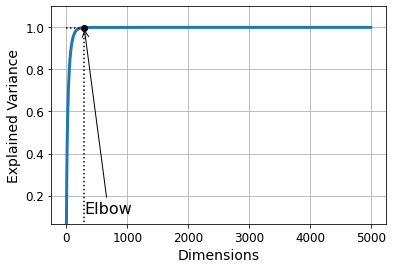

In [ ]:
plt.figure(figsize=(6,4))
plt.plot(cumsum_eig, linewidth=3)
plt.xlabel("Dimensions")
plt.ylabel("Explained Variance")
plt.ylim([cumsum_eig[0],1.1])
plt.plot([n_components_eig, n_components_eig], [0, p], "k:")
plt.plot([0, n_components_eig], [p, p], "k:")
plt.plot(n_components_eig, p, "ko")
plt.annotate("Elbow", xy=(n_components_eig, p), xytext=(n_components_eig, cumsum_eig[0]+0.05),
             arrowprops=dict(arrowstyle="->"), fontsize=16)
plt.grid(True)
plt.show()

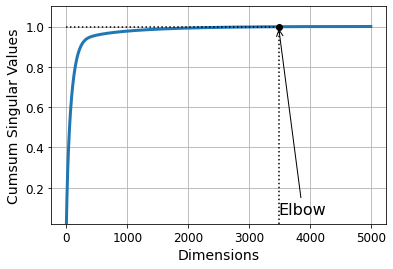

In [ ]:
p = 0.999
cumsum_sv = np.cumsum(pca.singular_values_/sum(pca.singular_values_))
n_components_sv = np.argmax(cumsum_sv >= p) + 1

d = n_components_sv
plt.figure(figsize=(6,4))
plt.plot(cumsum_sv, linewidth=3)
plt.xlabel("Dimensions")
plt.ylabel("Cumsum Singular Values")
plt.ylim([cumsum_sv[0],1.1])
plt.plot([d, d], [0, p], "k:")
plt.plot([0, d], [p, p], "k:")
plt.plot(d, p, "ko")
plt.annotate("Elbow", xy=(d, p), xytext=(d, cumsum_sv[0]+0.05),
             arrowprops=dict(arrowstyle="->"), fontsize=16)
plt.grid(True)
plt.show()
print(d)

In [ ]:
pca_rom = PCA(n_components=n_components_eig)
X_train_pca = pca_rom.fit_transform(X_train1d)
X_reconstruct = pca_rom.inverse_transform(X_train_pca)
print(X_train_pca.shape)
np.allclose(X_reconstruct, X_train1d)

(5000, 292)


False

In [ ]:
# Comparing actual data and pca reduced data
actual_data = X_train1d.reshape((-1, timestep, nx, nx))[89]
recon_data = X_reconstruct.reshape((-1, timestep, nx, nx))[89]

In [ ]:
plot_vortex(actual_data, times, len(times))

In [ ]:
plot_vortex(recon_data, times, len(times))

###Calculate Error

In [ ]:
max_abs_err, mean_abs_err = calculate_error(actual_data, recon_data)
print("Max. abs. error: {}". format(max_abs_err))
print("Mean abs. error: {}".format(mean_abs_err))

Max. abs. error: 0.0026068006677143927
Mean abs. error: 5.0103895884519914e-05


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: divide by zero encountered in true_divide
  """


###Save PCA model

In [ ]:
import joblib
pca_file_dir = "drive/MyDrive/MSC_IRP/PredGAN/pca_rom_292.pkl"
with open(pca_file_dir, 'wb') as save_file:  
  joblib.dump(pca_rom, save_file)
#np.save('drive/MyDrive/MSC_IRP/data/pca_calc_vortex_100.npy', X_train_pca)

#Training Prediction GAN

Following reduction in dimension, we can now proceed to train a GAN for prediction.

###Load Data

In [6]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

SAVE_DIR = 'drive/MyDrive/MSC_IRP/PredGAN/'

nx = 256 # len(X_train3d[0][0])
timestep = 50 # len(X_train3d[0])

print (nx)
print(timestep)

256
50


**CONFIG. SETTINGS**

In [7]:
normalize = False # flag to normalize training data before PCA or not.
mem_load = True
num_of_coeff = 292
ntimes = 7 # Consecutive times for the GAN
step = 3 # step between times


g_lr = 1e-4
d_lr = 1e-4
num_examples_to_generate = 15

BATCH_SIZE = 128
latent_space = 3000

# Seed and intitialization
seed = tf.random.normal([num_examples_to_generate, latent_space])

In [8]:
if (mem_load):
  pca = joblib.load('drive/MyDrive/MSC_IRP/PredGAN/pca_rom300_292.pkl')
  X_train1d_pca = np.load('drive/MyDrive/MSC_IRP/data/pca_calc_vortex_300.npy')
else: 
  # Load vortex data as traing data.
  X_train3d = np.load('drive/MyDrive/MSC_IRP/data/calc_vortex_100.npy')
  X_train1d = X_train3d.reshape((-1, nx*nx))
  if (normalize):
    X_train1d = StandardScaler().fit_transform(X_train1d)
  # 
  pca = PCA(num_of_coeff)
  X_train1d_pca = pca.fit_transform(X_train1d)
print(X_train1d_pca.shape)

(15000, 292)


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:318: UserWarning: Trying to unpickle estimator PCA from version 0.22.1 when using version 0.22.2.post1. This might lead to breaking code or invalid results. Use at your own risk.
  UserWarning)


In [9]:
# test 1
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
X_train1d_pca_scaled = scaler.fit_transform(X_train1d_pca)
np.allclose(X_train1d_pca, scaler.inverse_transform((X_train1d_pca_scaled)))


True

### Visualize Data

(100, 50, 256, 256)


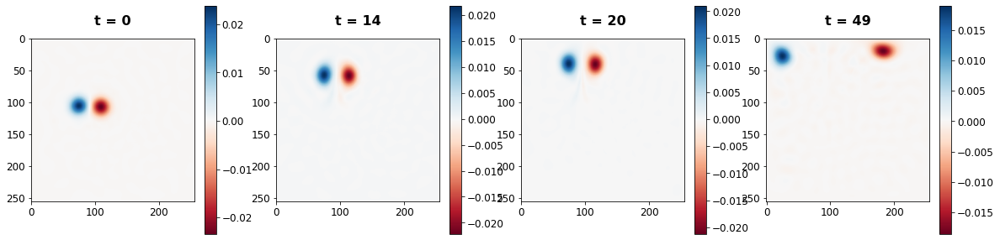

In [11]:
# Inverse PCA plots
times = [0, 14, 20, 49]
X_recovered = pca.inverse_transform(X_train1d_pca).reshape(-1,timestep, nx, nx)
print(X_recovered.shape)
plot_vortex(X_recovered[69], times, len(times))

(100, 50, 256, 256)


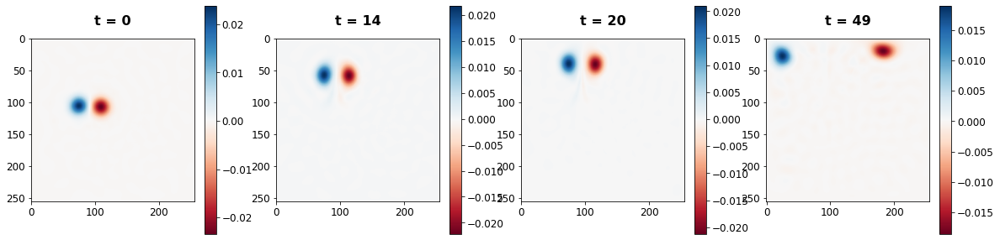

In [ ]:
# Inverse scaling and inverse PCA plots
X_recovered = invert_data(X_train1d_pca_scaled).reshape(-1,timestep, nx, nx)
print(X_recovered.shape)
plot_vortex(X_recovered[69], times, len(times))

### Time series Concatenation

In [10]:
sample_size = int(X_train1d_pca.shape[0]/timestep) # X_train3d.shape[0] #300 separate samples
window_start = [(sample*timestep)for sample in range(sample_size)]
window_end = [(sample*timestep) - (ntimes*step) for sample in range(1, sample_size + 1)]


X_train_concat = concat_timesteps(X_train1d_pca_scaled, ntimes, step, window_start, window_end)
X_train_concat_flatten = X_train_concat.reshape(X_train_concat.shape[0], num_of_coeff*ntimes)
print(X_train_concat.shape)
print(X_train_concat_flatten.shape)

(9600, 7, 292)
(9600, 2044)


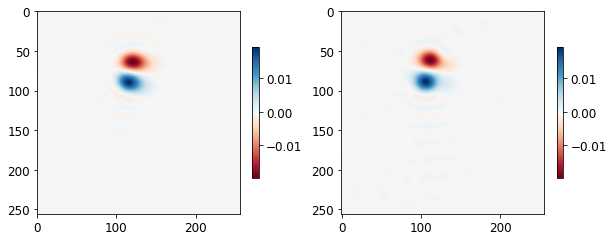

(7, 65536)


In [11]:
# Reverse transform concatenated series to check correctness
fig, ax = plt.subplots(1, 2, figsize=[10,10])
X_ = invert_data(X_train_concat[69, :, :])
im = ax[0].imshow(X_[0,:].reshape(nx, nx), cmap='RdBu')
im = ax[1].imshow(X_[1, :].reshape(nx, nx), cmap='RdBu')
fig.colorbar(im, ax=ax.flatten()[0], shrink=0.24, pad=0.05, panchor=(0.0, 0.0))
fig.colorbar(im, ax=ax.flatten()[1], shrink=0.24, pad=0.05, panchor=(0.0, 0.0))
plt.show()
print(X_.shape)


Dataset Creation

In [12]:
# Create a tensorflow dataset and split it into batches
train_dataset = X_train_concat.reshape(X_train_concat.shape[0], ntimes, num_of_coeff, 1).astype('float32')
train_dataset = tf.data.Dataset.from_tensor_slices(train_dataset)
train_dataset = train_dataset.shuffle(len(X_train_concat)).batch(BATCH_SIZE)

### W-GAN with GP - Alternate architecture

#### Load Models

In [69]:
from tensorflow.keras.models import load_model
generator = load_model(SAVE_DIR+'ganmodels/modelB/gen_vE3000_125b_wganB_292_0.h5', custom_objects={'generator_loss':generator_loss, 'gradient_penalty':gradient_penalty})
discriminator = load_model(SAVE_DIR+'ganmodels/modelB/disc_vE3000_125b_wganB_292_0.h5', custom_objects={'discriminator_loss':discriminator_loss})

np.random.seed(0)
tf.random.set_seed(0)

#### Build Models

In [13]:

generator_mean_loss = tf.keras.metrics.Mean(dtype=tf.float32)
discriminator_mean_loss = tf.keras.metrics.Mean(dtype=tf.float32)
g_lr = 1e-4
d_lr = 1e-4

# Optimizers for generator and optimizer models
generator_optimizer = tf.keras.optimizers.Adam(learning_rate=g_lr, beta_1=0.5, beta_2=0.9)
discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=d_lr, beta_1=0.5, beta_2=0.9)

def discriminator_loss(fake_output, real_output):
  return tf.reduce_mean(fake_output) - tf.reduce_mean(real_output)

def generator_loss(fake_output, real_output):
  return -tf.reduce_mean(fake_output)

Gradient Penalty

In [14]:
def gradient_penalty(f, real, fake):
    
    def _interpolate(a, b):
        shape = [BATCH_SIZE, 1, 1, 1]
        alpha = tf.random.uniform(shape=shape, minval=0., maxval=1.)
        inter = a + alpha * (b - a)
        return inter

    x = _interpolate(real, fake)
    with tf.GradientTape() as t:
        t.watch(x)
        pred = f(x)
    grad = t.gradient(pred, x)
    norm = tf.norm(tf.reshape(grad, [tf.shape(grad)[0], -1]), axis=1)
    gp = tf.reduce_mean((norm - 1.)**2)

    return gp

Generator Model

In [15]:
def make_generator_model():

    #weight initialization
    # init = tf.initializers.RandomNormal(stddev=0.02)
  
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.Dense(5*12*512, use_bias=False, input_shape=(latent_space,)))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.3))
  

    model.add(tf.keras.layers.Reshape((5, 12, 512)))

    model.add(tf.keras.layers.Conv2DTranspose(256, (3, 7), strides=(1, 1), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.3)) 

    model.add(tf.keras.layers.Conv2DTranspose(128, (3, 7), strides=(1, 2), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.3))

    model.add(tf.keras.layers.Conv2DTranspose(64, (3, 7), strides=(1, 2), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.3))

    model.add(tf.keras.layers.Conv2DTranspose(32, (3, 7), strides=(1, 2), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.3))

    model.add(tf.keras.layers.Conv2DTranspose(1, (3, 7), strides=(1, 3),padding ='valid', output_padding=[0,0], use_bias=False, activation='tanh'))

    model.compile(optimizer=generator_optimizer, loss=generator_loss)

    return model
generator = make_generator_model()
generator.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 30720)             92160000  
_________________________________________________________________
batch_normalization (BatchNo (None, 30720)             122880    
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 30720)             0         
_________________________________________________________________
reshape (Reshape)            (None, 5, 12, 512)        0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 5, 12, 256)        2752512   
_________________________________________________________________
batch_normalization_1 (Batch (None, 5, 12, 256)        1024      
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 5, 12, 256)        0

Discriminator / Critic

In [16]:
# Addition for WGAN implementation. 
from keras.constraints import Constraint
from keras import backend

class ClipConstraint(Constraint):
  def __init__(self, clip_value):
    self.clip_value = clip_value

  # clip value weights to hypercube
  def __call__(self, weights):
    return backend.clip(weights, -self.clip_value, self.clip_value)

  #get config 
  def get_config(self):
    return {'clip_value': self.clip_value}

In [17]:
clip_value = 0.01
def make_discriminator_model():
    # weight initialization
    init = tf.initializers.RandomNormal(stddev=0.02)
    # weight constraint
    # const = ClipConstraint(clip_value)

    model = tf.keras.Sequential()
    model.add(tf.keras.layers.Conv2D(64, (5, 5), strides=(3, 3), padding='same',
                                     input_shape=[ntimes, num_of_coeff, 1]))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(256, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(1))

    model.compile(optimizer=discriminator_optimizer, loss=discriminator_loss)
    return model
discriminator = make_discriminator_model()
discriminator.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 3, 98, 64)         1664      
_________________________________________________________________
leaky_re_lu_5 (LeakyReLU)    (None, 3, 98, 64)         0         
_________________________________________________________________
dropout (Dropout)            (None, 3, 98, 64)         0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 2, 49, 64)         102464    
_________________________________________________________________
leaky_re_lu_6 (LeakyReLU)    (None, 2, 49, 64)         0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 2, 49, 64)         0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 1, 25, 128)       

#### Test and Train

Testing the model generator

(1, 7, 292, 1)
(7, 65536)


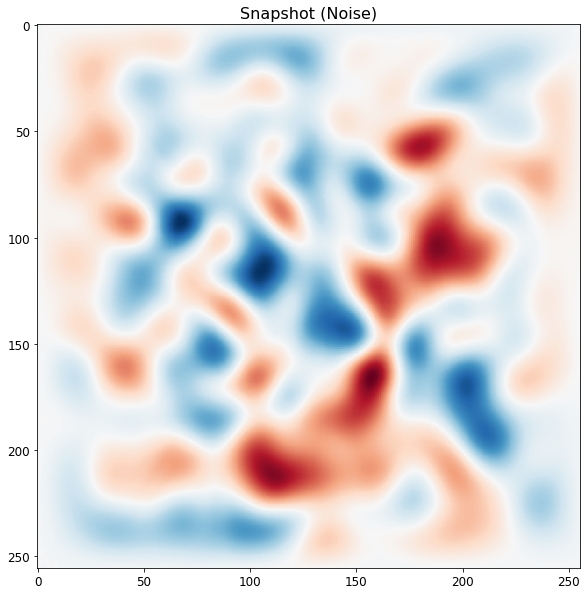

In [18]:
noise = tf.random.normal([1, latent_space])
generated_image = generator(noise, training=False)
print(generated_image.shape)

fig, ax = plt.subplots(figsize=[10,10])
inv_generated_image = invert_data(generated_image[0, :, :, 0])
print(inv_generated_image.shape)
ax.imshow(inv_generated_image[0, :].reshape(nx, nx), cmap='RdBu');
ax.set_title('Snapshot (Noise)', fontsize=16);

Test disciriminator model

In [19]:
decision = discriminator(generated_image)
print(decision)

tf.Tensor([[5.0169998e-05]], shape=(1, 1), dtype=float32)


Generative Model


In [22]:
gan = tf.keras.models.Sequential ([generator, discriminator])

In [20]:
# logs to document losses
#version_num = 'E3000_FT'
version_num = 'E3000_125b_wganB'

# generator_log_dir = SAVE_DIR + 'logs/generator_v' + str(version_num) + '_'+ str(num_of_coeff)
# discriminator_log_dir = SAVE_DIR + 'logs/discriminator_v' + str(version_num) + '_'+ str(num_of_coeff)
# gen_summary = tf.summary.create_file_writer(generator_log_dir)
# disc_summary = tf.summary.create_file_writer(discriminator_log_dir)


print('Version no.: ', version_num)
print('POD coeffiecients: ', num_of_coeff)
print('Batch size: ', BATCH_SIZE)
print('Learning Rate: ', g_lr, '(gen),', d_lr, '(disc)')
print('Instances: ', ntimes)
print('Time steps: ', step)

Version no.:  E3000_125b_wganB
POD coeffiecients:  292
Batch size:  128
Learning Rate:  0.0001 (gen), 0.0001 (disc)
Instances:  7
Time steps:  3


Training step

In [21]:
@tf.function
def train_step(batch, n_critic):
    noise = tf.random.normal([BATCH_SIZE, latent_space])

    # Discriminator training 
    for i in range(n_critic):
      losses_d = [] 
      with tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)
        
        fake_output = discriminator(generated_images, training=True)
        real_output = discriminator(batch, training=True)
        
        # Wasserstein Loss
        disc_wloss_noGP = discriminator_loss(fake_output, real_output)
        gp = gradient_penalty(functools.partial(discriminator, training=True), batch, generated_images)
        disc_wloss = disc_wloss_noGP + gp*10.0
       
      gradients_of_discriminator = disc_tape.gradient(disc_wloss, discriminator.trainable_variables)
      discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
      losses_d.append(disc_wloss_noGP)
    discriminator_mean_loss(losses_d)

    # Generator training 
    with tf.GradientTape() as gen_tape:
        generated_images = generator(noise, training=True)
        fake_output = discriminator(generated_images, training=True)

        # Wasserstein Loss
        gen_wloss = generator_loss(fake_output, real_output)
    
    gradients_of_generator = gen_tape.gradient(gen_wloss, generator.trainable_variables)
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
   
    generator_mean_loss(gen_wloss)
    return gp

**Train GAN**

In [24]:
def train(dataset, epochs, n_critic):
    hist = []
    for epoch in range(epochs+1):
        start = time.time()
        print("Epoch {}/{}".format(epoch + 1, epochs))   

        for batch in dataset:
           gp = train_step(batch, n_critic)


        # with gen_summary.as_default():
        #     tf.summary.scalar('loss', generator_mean_loss.result(), step=epoch)

        # with disc_summary.as_default():
        #     tf.summary.scalar('loss', discriminator_mean_loss.result(), step=epoch)
        
        hist.append([generator_mean_loss.result().numpy(), discriminator_mean_loss.result().numpy()])

        generator_mean_loss.reset_states()
        discriminator_mean_loss.reset_states()
        

        print("discriminator loss: ", "{:.7f}".format(hist[-1][1]), end=' - ')
        print("generator loss: ", "{:.7f}".format(hist[-1][0]), end=' - ')
        print("gradient penalty: ", "{:.7f}".format(gp), end=' - ')    
        print ('{:.0f}s'.format( time.time()-start))

        pred_time_len = 4
        # Global variables are used below
        if epoch%100 == 0: 
            # Plot generated data
            X_generated = generator.predict(seed).reshape(-1, num_of_coeff)
            X_generated = invert_data(X_generated)
            print(X_generated.shape)
            X_generated = X_generated.reshape(num_examples_to_generate, ntimes, nx, nx)
            fig, ax = plt.subplots(5, pred_time_len, figsize=[20, 25], constrained_layout=True)
            for j in range(5):
              for i in range(pred_time_len):
                im = ax.flatten()[i + (pred_time_len*j)].imshow(X_generated[j][i,:,:], cmap='RdBu')
                ax[j,i].set_xticklabels([]), ax[j,i].set_yticklabels([])
              fig.colorbar(im, ax=ax[j,:], location='right', shrink=0.8, pad=0.05)
            plt.show() 
                    
            
            # plot loss
            print('Loss: ')
            fig, ax = plt.subplots(1,1, figsize=[20,10])
            ax.plot(hist)
            ax.legend(['loss_gen', 'loss_disc'])
            ax.set_yscale('log')
            ax.grid()
            plt.show()
        if epoch%1000 == 0:          
            # Save model once 
            discriminator.save(SAVE_DIR + 'ganmodels/modelB/Loaddisc_v'+ str(version_num) + '_'+ 
                                          str(num_of_coeff)+'_'+str(epoch)+'.h5', include_optimizer=True)
            generator.save(SAVE_DIR + 'ganmodels/modelB/Loadgen_v'+ str(version_num) + '_'+ 
                                          str(num_of_coeff)+'_'+str(epoch) + '.h5', include_optimizer=True)  
    return hist

discriminator loss:  -0.2686584 - generator loss:  1.5723866 - gradient penalty:  0.0037610 - 12s
Epoch 1562/20000
discriminator loss:  -0.2715310 - generator loss:  1.7314954 - gradient penalty:  0.0048965 - 12s
Epoch 1563/20000
discriminator loss:  -0.2857063 - generator loss:  1.7341493 - gradient penalty:  0.0047496 - 12s
Epoch 1564/20000
discriminator loss:  -0.2656060 - generator loss:  1.7358850 - gradient penalty:  0.0040607 - 12s
Epoch 1565/20000
discriminator loss:  -0.2828174 - generator loss:  1.5824109 - gradient penalty:  0.0052458 - 12s
Epoch 1566/20000
discriminator loss:  -0.2638550 - generator loss:  1.6237190 - gradient penalty:  0.0038162 - 12s
Epoch 1567/20000
discriminator loss:  -0.2686744 - generator loss:  1.7057892 - gradient penalty:  0.0031219 - 12s
Epoch 1568/20000
discriminator loss:  -0.2643203 - generator loss:  1.5822561 - gradient penalty:  0.0042222 - 12s
Epoch 1569/20000
discriminator loss:  -0.2737695 - generator loss:  1.6209469 - gradient penalty:

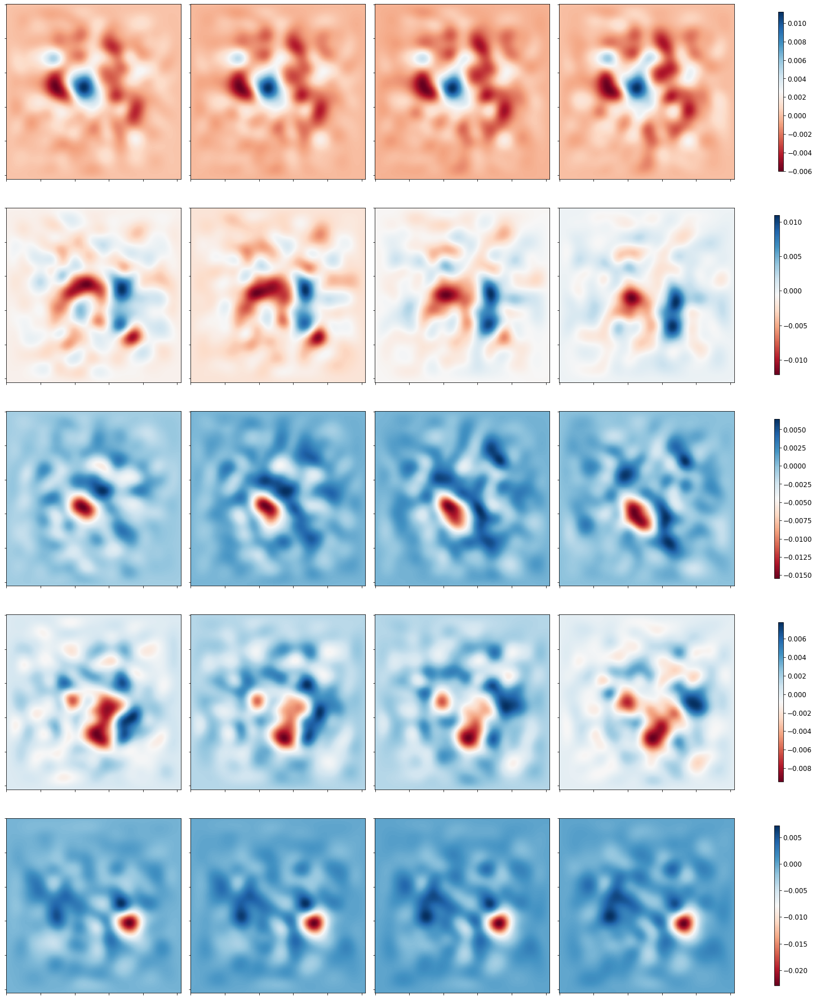

Loss: 


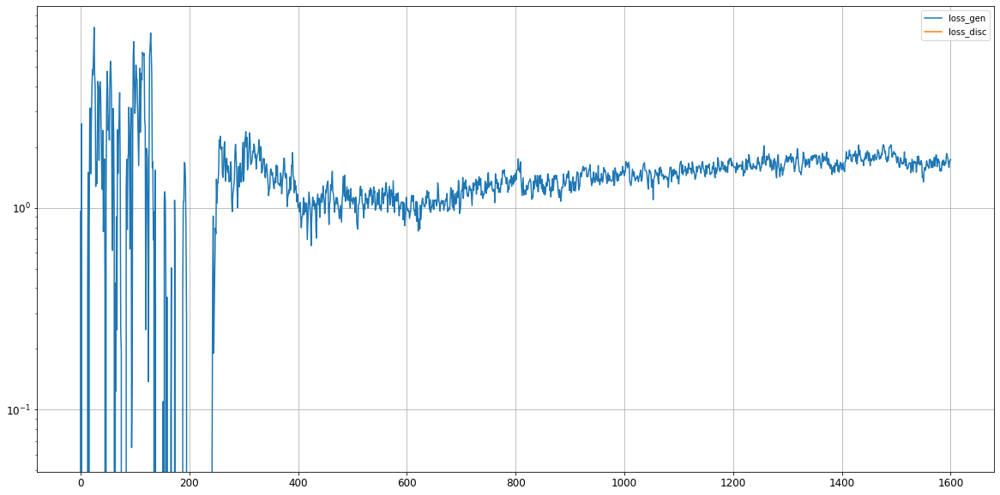

Epoch 1602/20000
discriminator loss:  -0.2634827 - generator loss:  1.7073728 - gradient penalty:  0.0048151 - 12s
Epoch 1603/20000
discriminator loss:  -0.2816178 - generator loss:  1.6713333 - gradient penalty:  0.0038199 - 12s
Epoch 1604/20000
discriminator loss:  -0.2741773 - generator loss:  1.6640558 - gradient penalty:  0.0038961 - 12s
Epoch 1605/20000
discriminator loss:  -0.2746958 - generator loss:  1.6543218 - gradient penalty:  0.0043716 - 12s
Epoch 1606/20000
discriminator loss:  -0.2719798 - generator loss:  1.6605278 - gradient penalty:  0.0035897 - 12s
Epoch 1607/20000
discriminator loss:  -0.2722945 - generator loss:  1.5900570 - gradient penalty:  0.0038006 - 12s
Epoch 1608/20000
discriminator loss:  -0.2704101 - generator loss:  1.6587757 - gradient penalty:  0.0040832 - 12s
Epoch 1609/20000
discriminator loss:  -0.2577625 - generator loss:  1.7241246 - gradient penalty:  0.0047452 - 12s
Epoch 1610/20000
discriminator loss:  -0.2713620 - generator loss:  1.7606366 - 

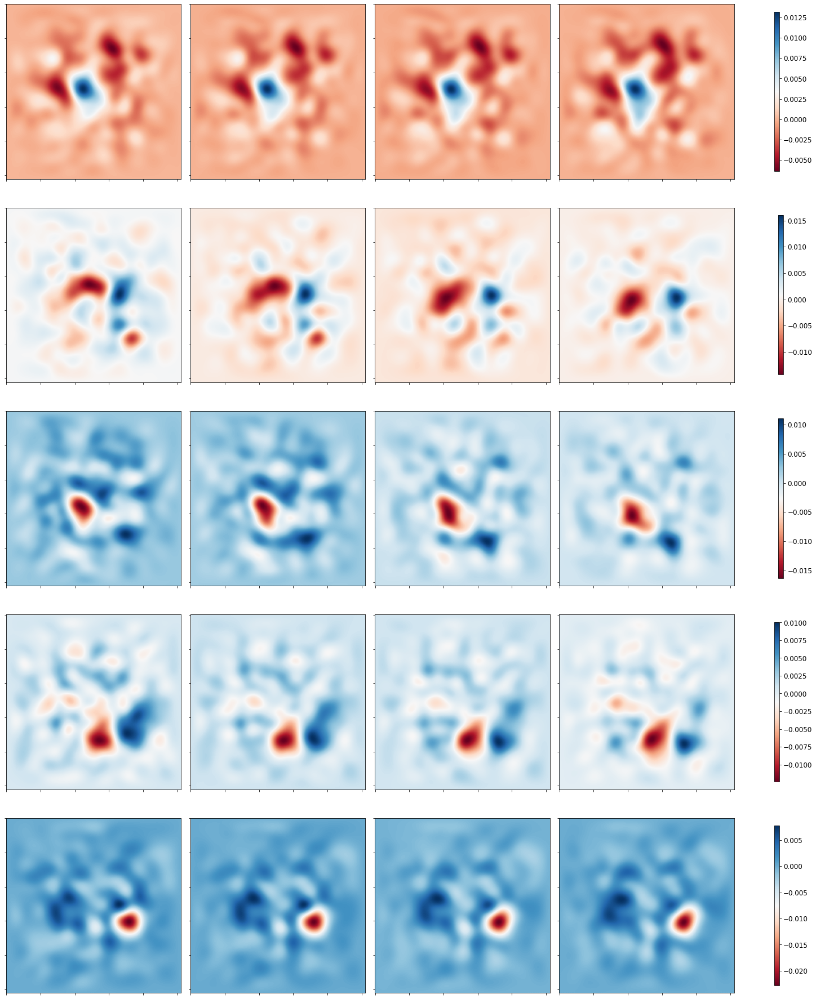

Loss: 


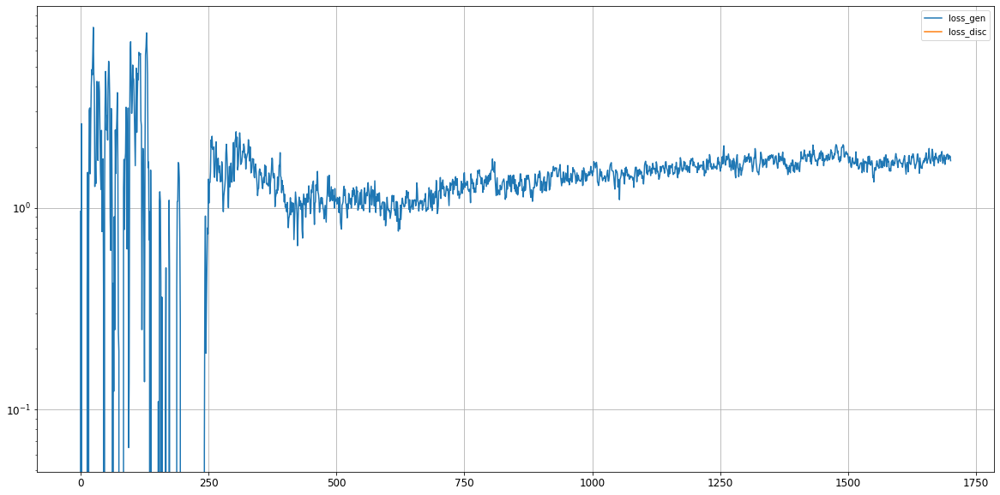

Epoch 1702/20000
discriminator loss:  -0.2696413 - generator loss:  1.7228072 - gradient penalty:  0.0048202 - 12s
Epoch 1703/20000
discriminator loss:  -0.2686396 - generator loss:  1.8419077 - gradient penalty:  0.0050772 - 12s
Epoch 1704/20000
discriminator loss:  -0.2613592 - generator loss:  1.9349209 - gradient penalty:  0.0052270 - 12s
Epoch 1705/20000
discriminator loss:  -0.2614894 - generator loss:  1.7226251 - gradient penalty:  0.0048115 - 12s
Epoch 1706/20000
discriminator loss:  -0.2608412 - generator loss:  1.6749129 - gradient penalty:  0.0034901 - 12s
Epoch 1707/20000
discriminator loss:  -0.2634369 - generator loss:  1.8415942 - gradient penalty:  0.0032735 - 12s
Epoch 1708/20000
discriminator loss:  -0.2610545 - generator loss:  1.7784231 - gradient penalty:  0.0051591 - 12s
Epoch 1709/20000
discriminator loss:  -0.2696423 - generator loss:  1.7482715 - gradient penalty:  0.0051985 - 12s
Epoch 1710/20000
discriminator loss:  -0.2699136 - generator loss:  1.7373105 - 

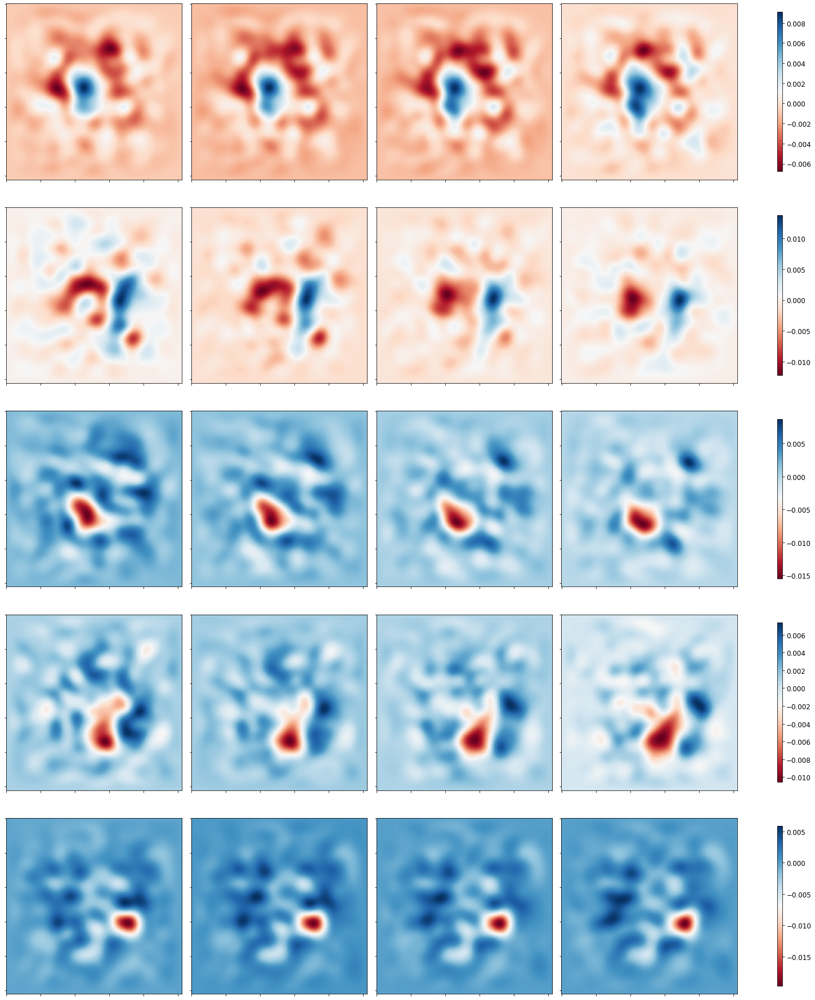

Loss: 


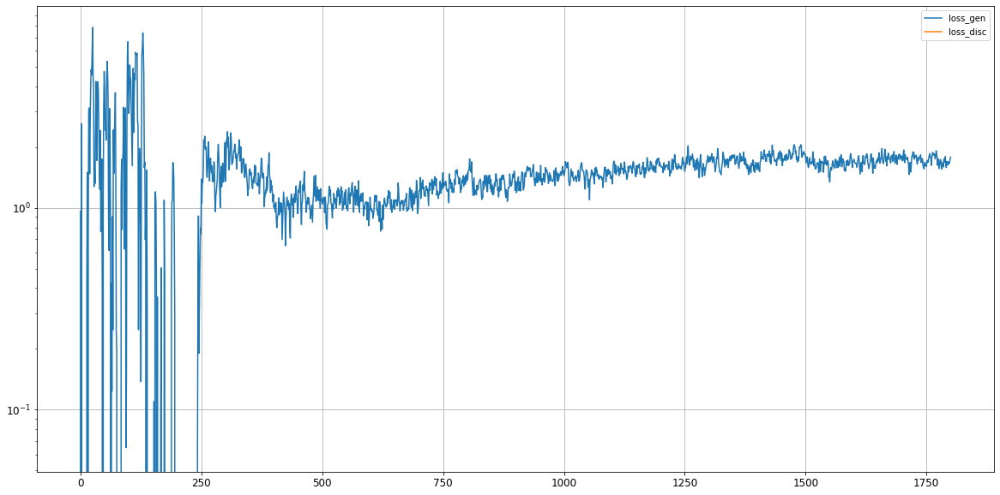

Epoch 1802/20000
discriminator loss:  -0.2529682 - generator loss:  1.7577120 - gradient penalty:  0.0040571 - 12s
Epoch 1803/20000
discriminator loss:  -0.2573548 - generator loss:  1.7413062 - gradient penalty:  0.0047732 - 12s
Epoch 1804/20000
discriminator loss:  -0.2604086 - generator loss:  1.7931994 - gradient penalty:  0.0050998 - 12s
Epoch 1805/20000
discriminator loss:  -0.2539268 - generator loss:  1.8146155 - gradient penalty:  0.0034629 - 12s
Epoch 1806/20000
discriminator loss:  -0.2671553 - generator loss:  1.6504360 - gradient penalty:  0.0046033 - 12s
Epoch 1807/20000
discriminator loss:  -0.2607007 - generator loss:  1.6531488 - gradient penalty:  0.0039041 - 12s
Epoch 1808/20000
discriminator loss:  -0.2688213 - generator loss:  1.7195973 - gradient penalty:  0.0041691 - 12s
Epoch 1809/20000
discriminator loss:  -0.2562542 - generator loss:  1.7267570 - gradient penalty:  0.0042205 - 12s
Epoch 1810/20000
discriminator loss:  -0.2631232 - generator loss:  1.6960360 - 

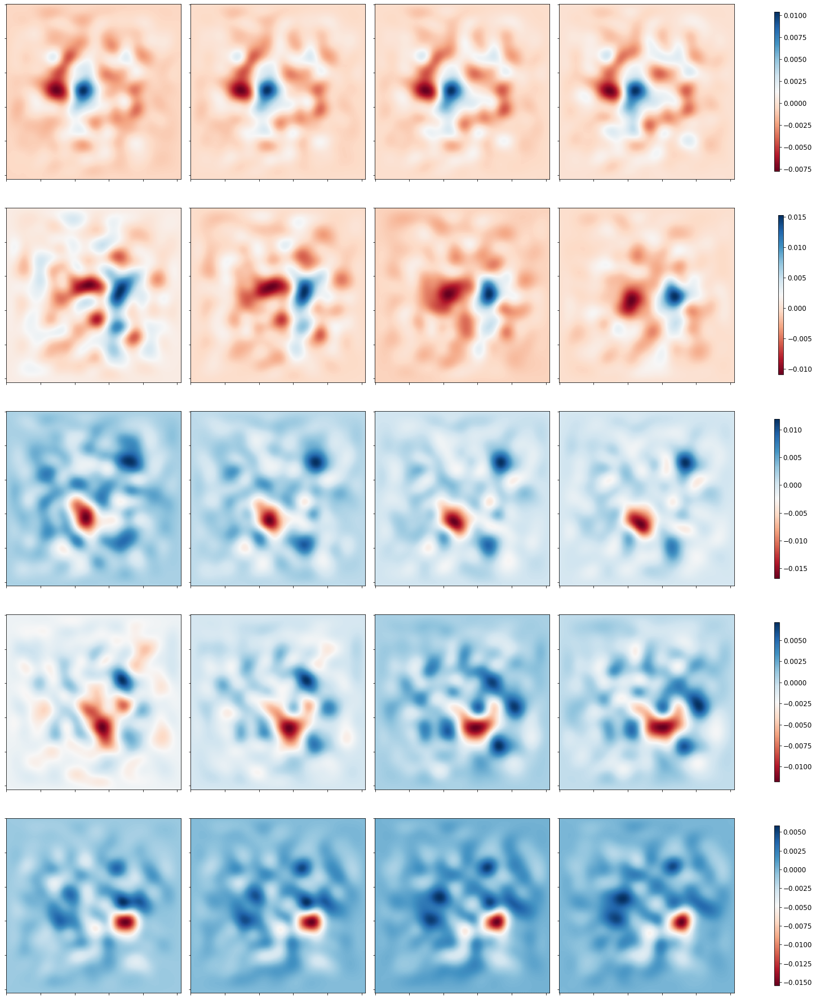

Loss: 


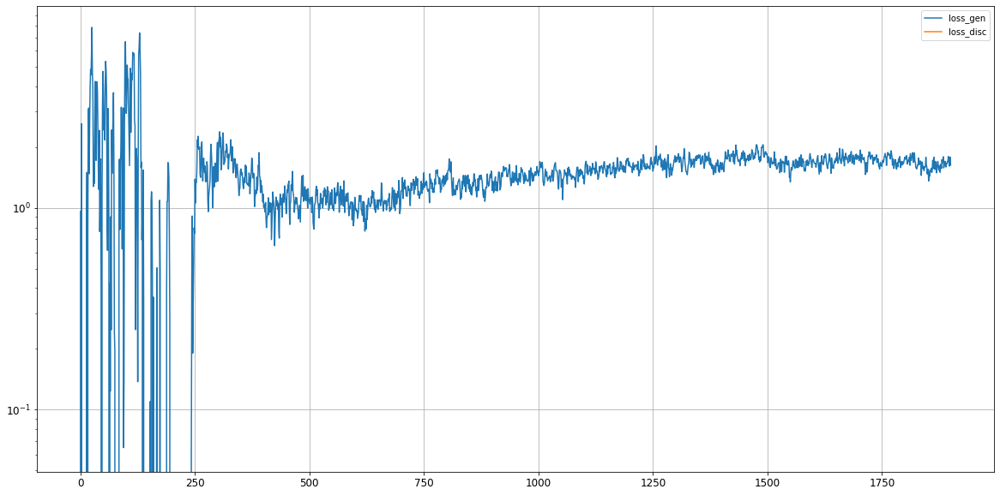

Epoch 1902/20000
discriminator loss:  -0.2584178 - generator loss:  1.6445413 - gradient penalty:  0.0037712 - 12s
Epoch 1903/20000
discriminator loss:  -0.2541515 - generator loss:  1.5751948 - gradient penalty:  0.0047771 - 12s
Epoch 1904/20000
discriminator loss:  -0.2606807 - generator loss:  1.5993624 - gradient penalty:  0.0033378 - 12s
Epoch 1905/20000
discriminator loss:  -0.2558625 - generator loss:  1.5322553 - gradient penalty:  0.0038102 - 12s
Epoch 1906/20000
discriminator loss:  -0.2564637 - generator loss:  1.5437452 - gradient penalty:  0.0053407 - 12s
Epoch 1907/20000
discriminator loss:  -0.2563823 - generator loss:  1.6581368 - gradient penalty:  0.0038997 - 12s
Epoch 1908/20000
discriminator loss:  -0.2737086 - generator loss:  1.7024353 - gradient penalty:  0.0036275 - 12s
Epoch 1909/20000
discriminator loss:  -0.2631917 - generator loss:  1.6367528 - gradient penalty:  0.0045682 - 12s
Epoch 1910/20000
discriminator loss:  -0.2636739 - generator loss:  1.6318122 - 

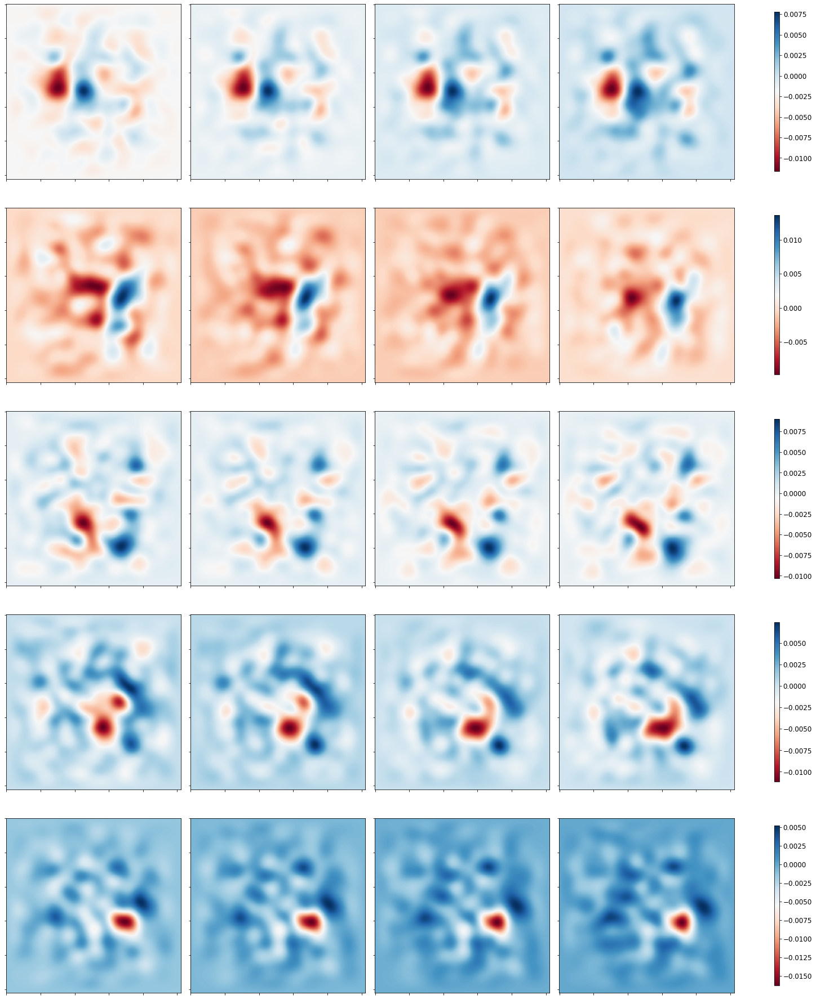

Loss: 


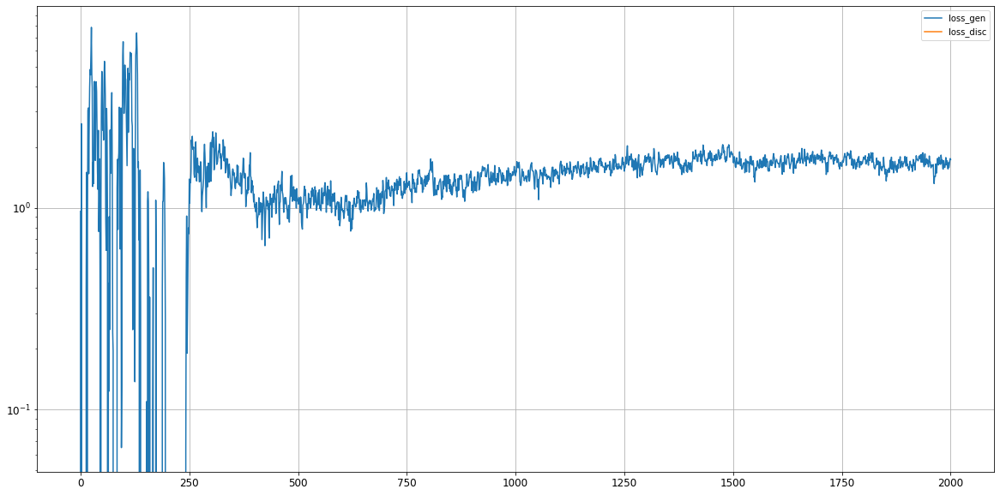

Epoch 2002/20000
discriminator loss:  -0.2625527 - generator loss:  1.6157036 - gradient penalty:  0.0058907 - 12s
Epoch 2003/20000
discriminator loss:  -0.2576408 - generator loss:  1.6196431 - gradient penalty:  0.0043720 - 12s
Epoch 2004/20000
discriminator loss:  -0.2505732 - generator loss:  1.5949675 - gradient penalty:  0.0037359 - 12s
Epoch 2005/20000
discriminator loss:  -0.2500805 - generator loss:  1.6418833 - gradient penalty:  0.0044590 - 12s
Epoch 2006/20000
discriminator loss:  -0.2573791 - generator loss:  1.4956495 - gradient penalty:  0.0042516 - 12s
Epoch 2007/20000
discriminator loss:  -0.2609232 - generator loss:  1.3916351 - gradient penalty:  0.0035466 - 12s
Epoch 2008/20000
discriminator loss:  -0.2680392 - generator loss:  1.6368413 - gradient penalty:  0.0047913 - 12s
Epoch 2009/20000
discriminator loss:  -0.2581854 - generator loss:  1.6715925 - gradient penalty:  0.0046366 - 12s
Epoch 2010/20000
discriminator loss:  -0.2476425 - generator loss:  1.7470634 - 

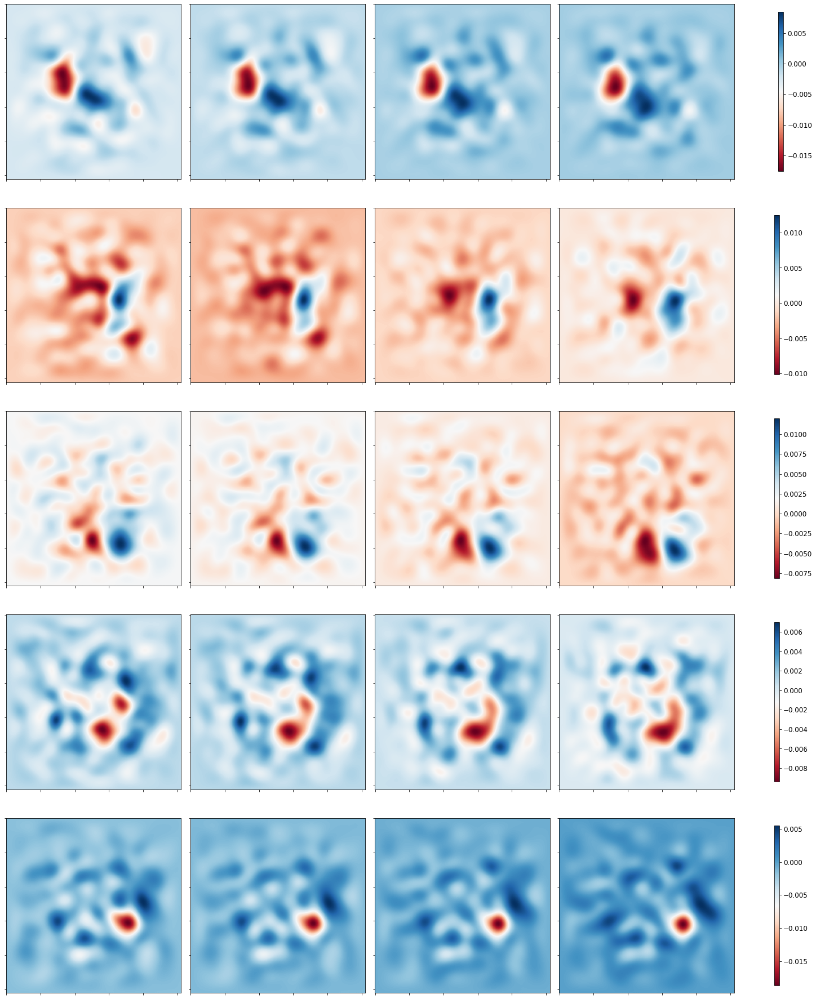

Loss: 


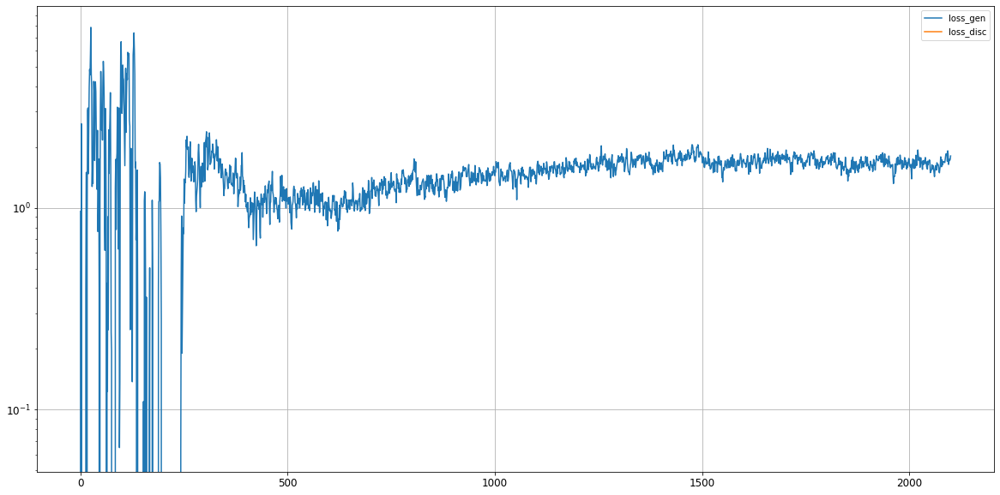

Epoch 2102/20000
discriminator loss:  -0.2580700 - generator loss:  1.7030251 - gradient penalty:  0.0035598 - 12s
Epoch 2103/20000
discriminator loss:  -0.2544899 - generator loss:  1.6041110 - gradient penalty:  0.0043032 - 12s
Epoch 2104/20000
discriminator loss:  -0.2550973 - generator loss:  1.5265713 - gradient penalty:  0.0044520 - 12s
Epoch 2105/20000
discriminator loss:  -0.2490051 - generator loss:  1.7418630 - gradient penalty:  0.0046298 - 12s
Epoch 2106/20000
discriminator loss:  -0.2559483 - generator loss:  1.6642122 - gradient penalty:  0.0040149 - 12s
Epoch 2107/20000
discriminator loss:  -0.2591906 - generator loss:  1.7961487 - gradient penalty:  0.0052458 - 12s
Epoch 2108/20000
discriminator loss:  -0.2573565 - generator loss:  1.7567613 - gradient penalty:  0.0039296 - 12s
Epoch 2109/20000
discriminator loss:  -0.2554251 - generator loss:  1.6569030 - gradient penalty:  0.0039141 - 12s
Epoch 2110/20000
discriminator loss:  -0.2483792 - generator loss:  1.7202796 - 

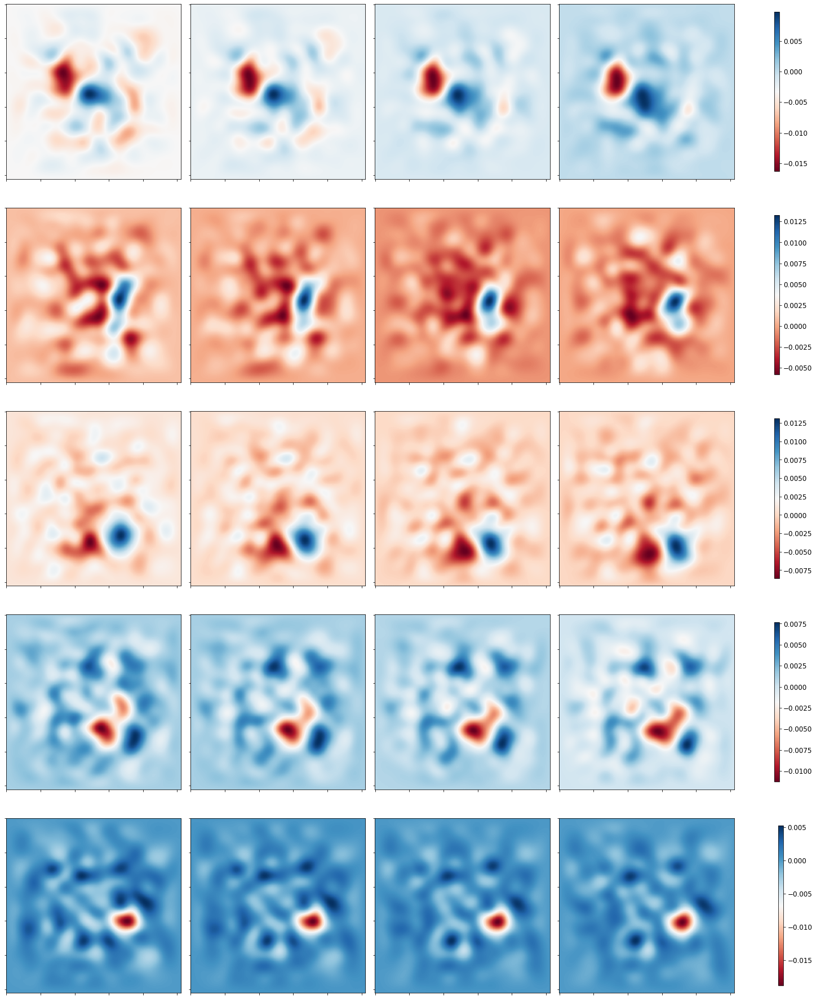

Loss: 


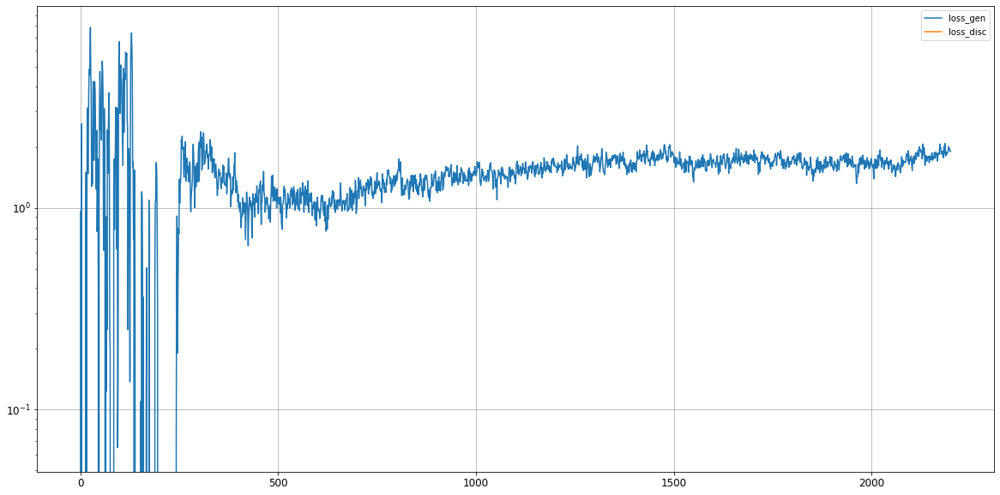

Epoch 2202/20000
discriminator loss:  -0.2553261 - generator loss:  1.9002604 - gradient penalty:  0.0034529 - 12s
Epoch 2203/20000
discriminator loss:  -0.2502715 - generator loss:  1.8518701 - gradient penalty:  0.0035709 - 12s
Epoch 2204/20000
discriminator loss:  -0.2475753 - generator loss:  1.9181265 - gradient penalty:  0.0039876 - 12s
Epoch 2205/20000
discriminator loss:  -0.2483251 - generator loss:  2.0495017 - gradient penalty:  0.0036618 - 12s
Epoch 2206/20000
discriminator loss:  -0.2595330 - generator loss:  1.9744582 - gradient penalty:  0.0039972 - 12s
Epoch 2207/20000
discriminator loss:  -0.2498159 - generator loss:  1.9950267 - gradient penalty:  0.0045208 - 12s
Epoch 2208/20000
discriminator loss:  -0.2535874 - generator loss:  1.9847964 - gradient penalty:  0.0038063 - 12s
Epoch 2209/20000
discriminator loss:  -0.2574066 - generator loss:  2.0424247 - gradient penalty:  0.0047829 - 12s
Epoch 2210/20000
discriminator loss:  -0.2610744 - generator loss:  2.1535997 - 

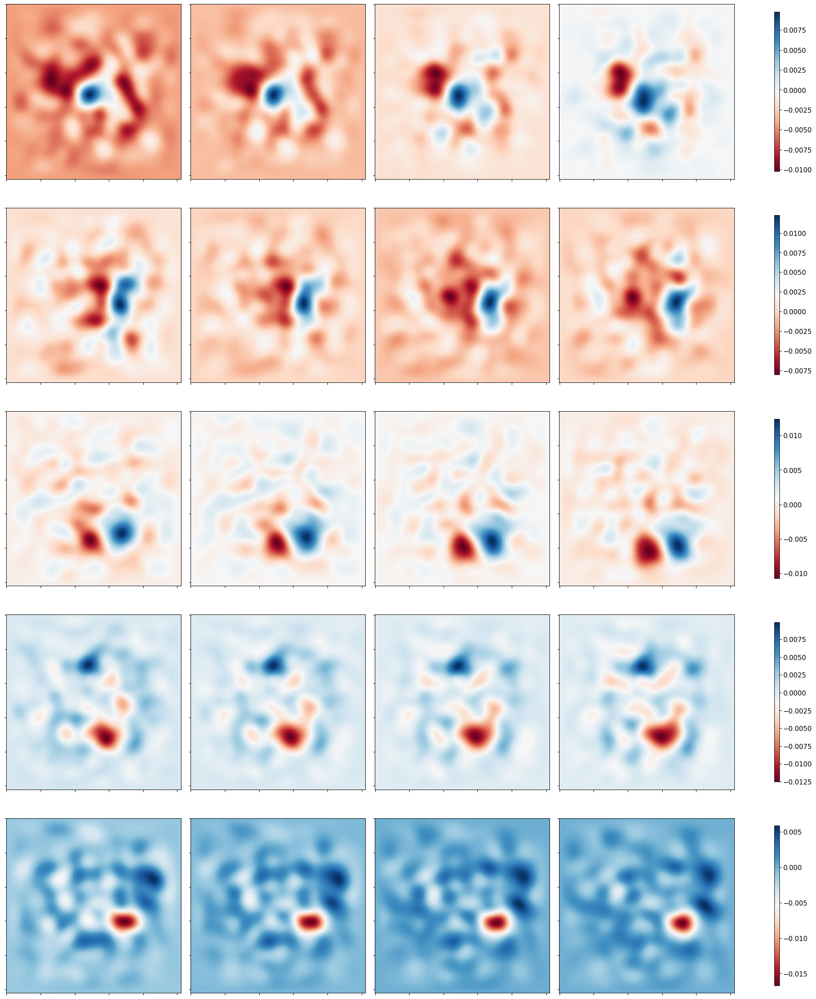

Loss: 


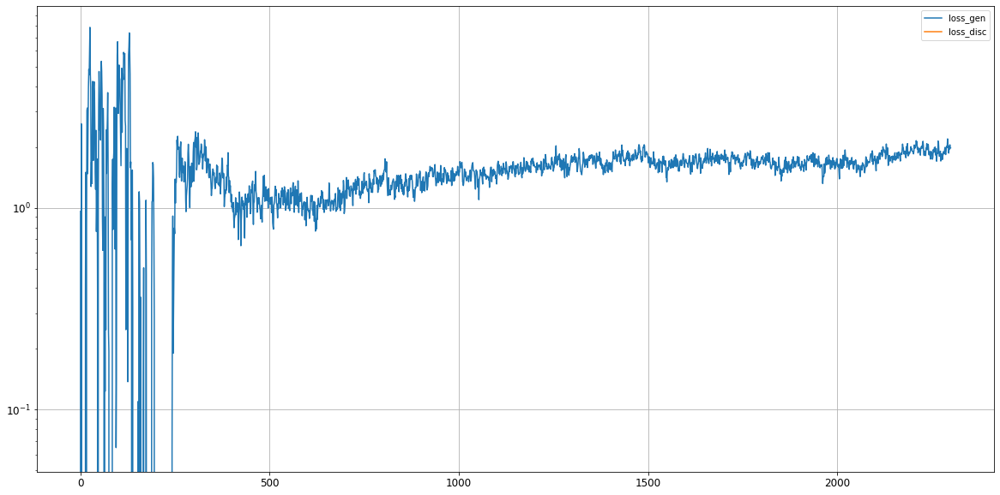

Epoch 2302/20000
discriminator loss:  -0.2561165 - generator loss:  1.9900409 - gradient penalty:  0.0044423 - 12s
Epoch 2303/20000
discriminator loss:  -0.2470880 - generator loss:  1.8995788 - gradient penalty:  0.0031697 - 12s
Epoch 2304/20000
discriminator loss:  -0.2421168 - generator loss:  1.9040835 - gradient penalty:  0.0033872 - 12s
Epoch 2305/20000
discriminator loss:  -0.2518674 - generator loss:  1.8776323 - gradient penalty:  0.0039448 - 12s
Epoch 2306/20000
discriminator loss:  -0.2428588 - generator loss:  1.8999076 - gradient penalty:  0.0031839 - 12s
Epoch 2307/20000
discriminator loss:  -0.2402916 - generator loss:  1.8575226 - gradient penalty:  0.0045472 - 12s
Epoch 2308/20000
discriminator loss:  -0.2397296 - generator loss:  1.9770968 - gradient penalty:  0.0041080 - 12s
Epoch 2309/20000
discriminator loss:  -0.2424711 - generator loss:  1.9264077 - gradient penalty:  0.0046921 - 12s
Epoch 2310/20000
discriminator loss:  -0.2498582 - generator loss:  1.9235315 - 

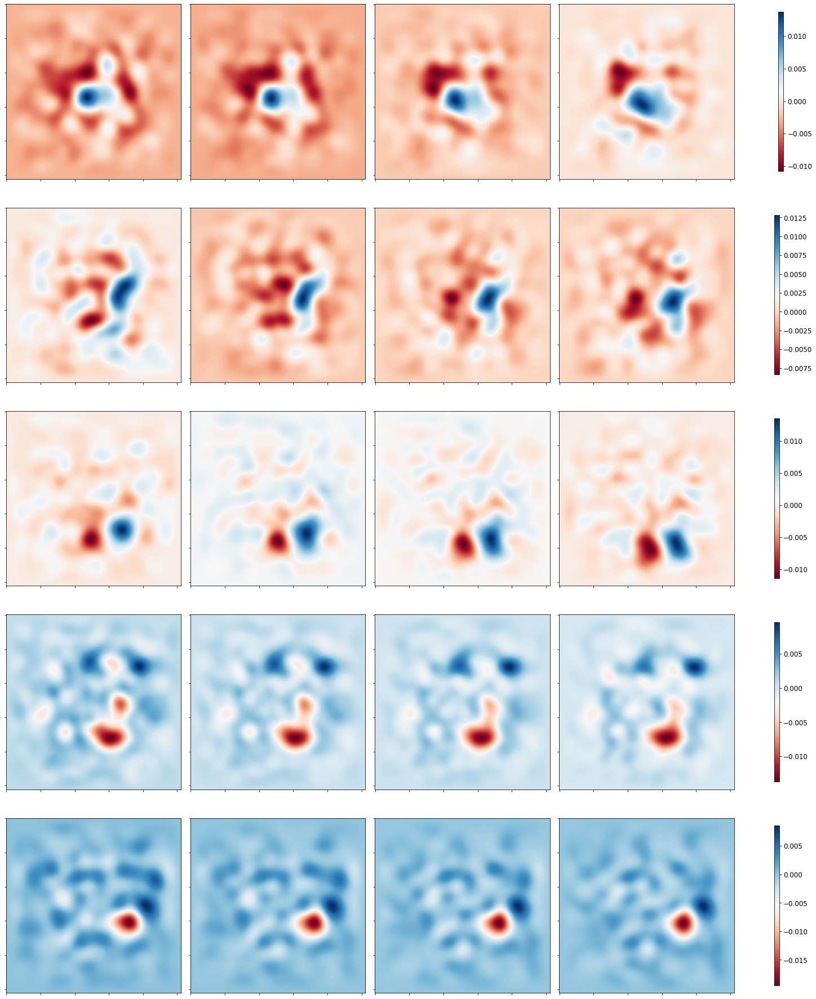

Loss: 


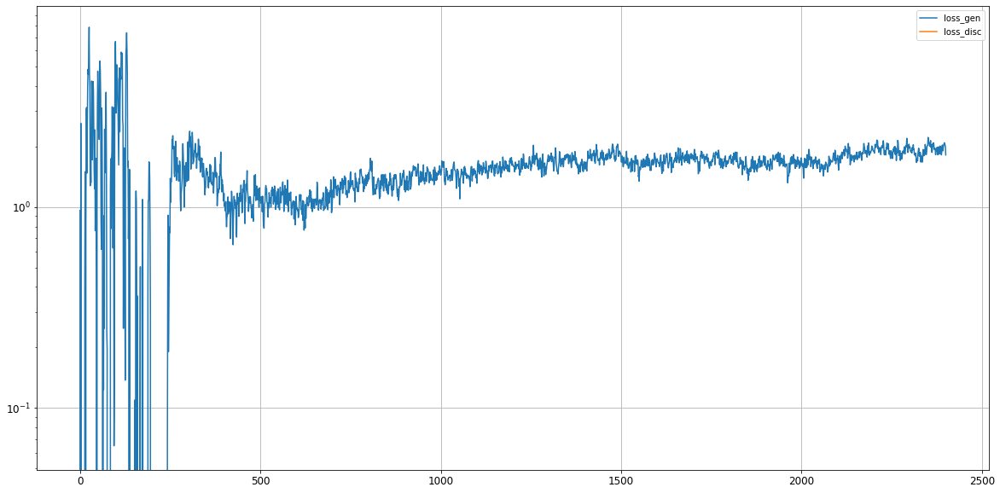

Epoch 2402/20000
discriminator loss:  -0.2354159 - generator loss:  1.9358906 - gradient penalty:  0.0037679 - 12s
Epoch 2403/20000
discriminator loss:  -0.2541458 - generator loss:  2.1513946 - gradient penalty:  0.0048237 - 12s
Epoch 2404/20000
discriminator loss:  -0.2369980 - generator loss:  1.8905686 - gradient penalty:  0.0037429 - 12s
Epoch 2405/20000
discriminator loss:  -0.2496202 - generator loss:  2.0087740 - gradient penalty:  0.0040656 - 12s
Epoch 2406/20000
discriminator loss:  -0.2461170 - generator loss:  1.8972274 - gradient penalty:  0.0046451 - 12s
Epoch 2407/20000
discriminator loss:  -0.2410817 - generator loss:  1.9045551 - gradient penalty:  0.0034139 - 12s
Epoch 2408/20000
discriminator loss:  -0.2454749 - generator loss:  1.9720258 - gradient penalty:  0.0041464 - 12s
Epoch 2409/20000
discriminator loss:  -0.2413294 - generator loss:  2.0095272 - gradient penalty:  0.0030809 - 12s
Epoch 2410/20000
discriminator loss:  -0.2358320 - generator loss:  2.0778067 - 

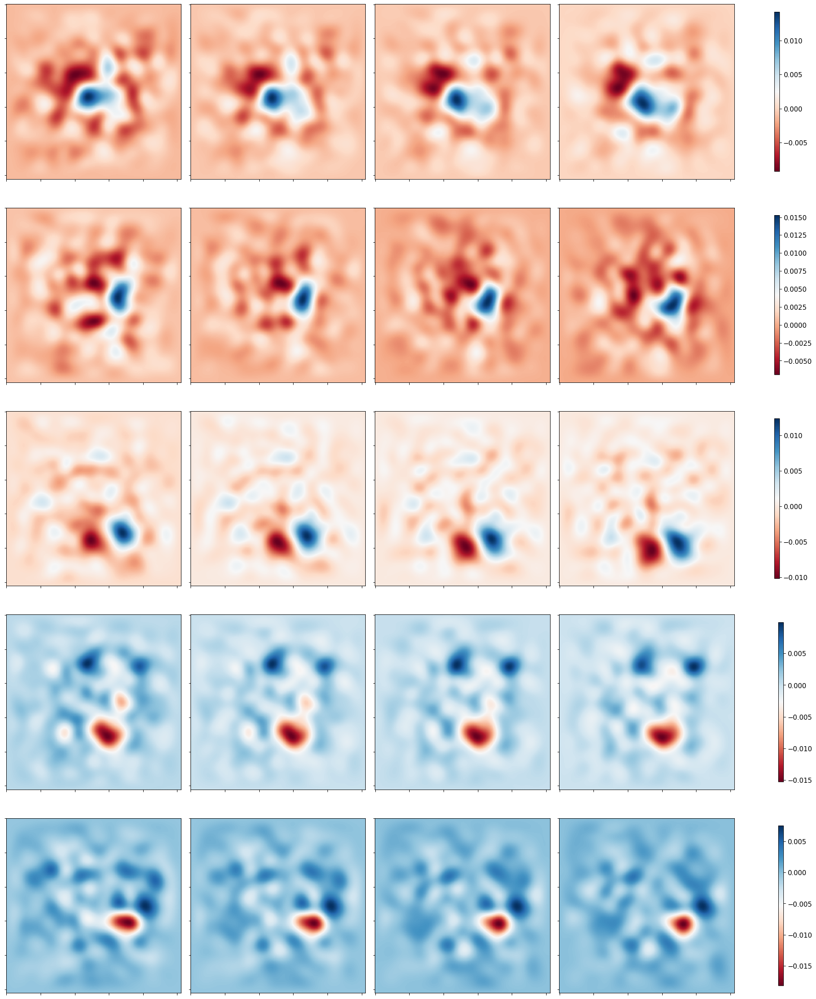

Loss: 


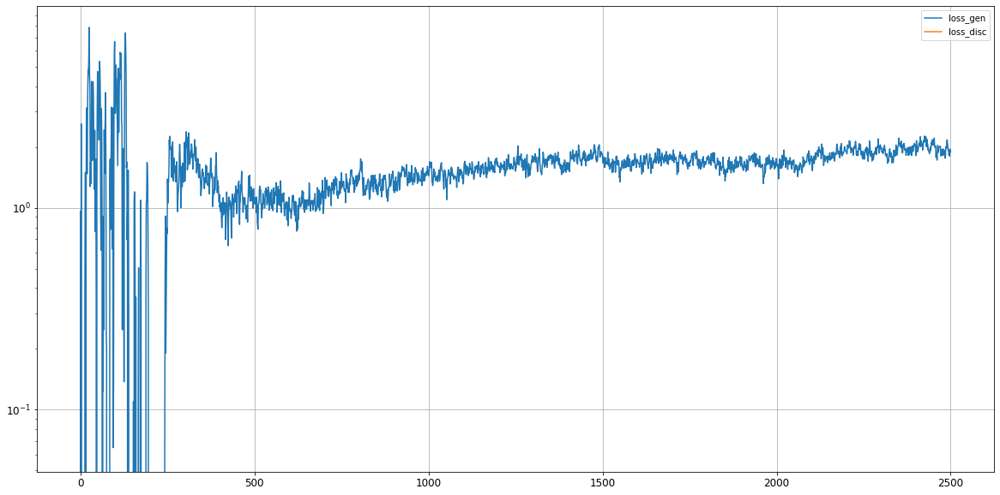

Epoch 2502/20000
discriminator loss:  -0.2505904 - generator loss:  1.9156797 - gradient penalty:  0.0044585 - 12s
Epoch 2503/20000
discriminator loss:  -0.2449715 - generator loss:  1.9011872 - gradient penalty:  0.0044124 - 12s
Epoch 2504/20000
discriminator loss:  -0.2366678 - generator loss:  1.8170699 - gradient penalty:  0.0043053 - 12s
Epoch 2505/20000
discriminator loss:  -0.2525172 - generator loss:  1.8564928 - gradient penalty:  0.0039498 - 12s
Epoch 2506/20000
discriminator loss:  -0.2483176 - generator loss:  1.8742561 - gradient penalty:  0.0040579 - 12s
Epoch 2507/20000
discriminator loss:  -0.2519209 - generator loss:  1.8079892 - gradient penalty:  0.0040710 - 12s
Epoch 2508/20000
discriminator loss:  -0.2491262 - generator loss:  1.8570908 - gradient penalty:  0.0039940 - 12s
Epoch 2509/20000
discriminator loss:  -0.2547049 - generator loss:  1.9090766 - gradient penalty:  0.0042085 - 12s
Epoch 2510/20000
discriminator loss:  -0.2380298 - generator loss:  1.8105227 - 

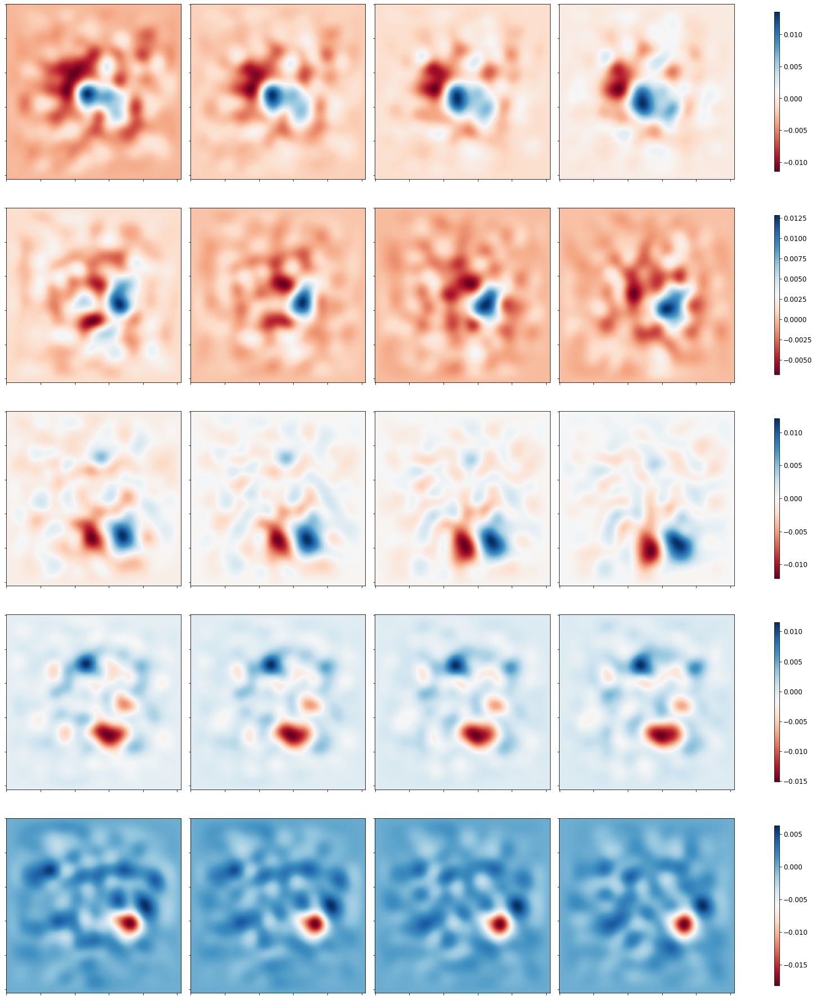

Loss: 


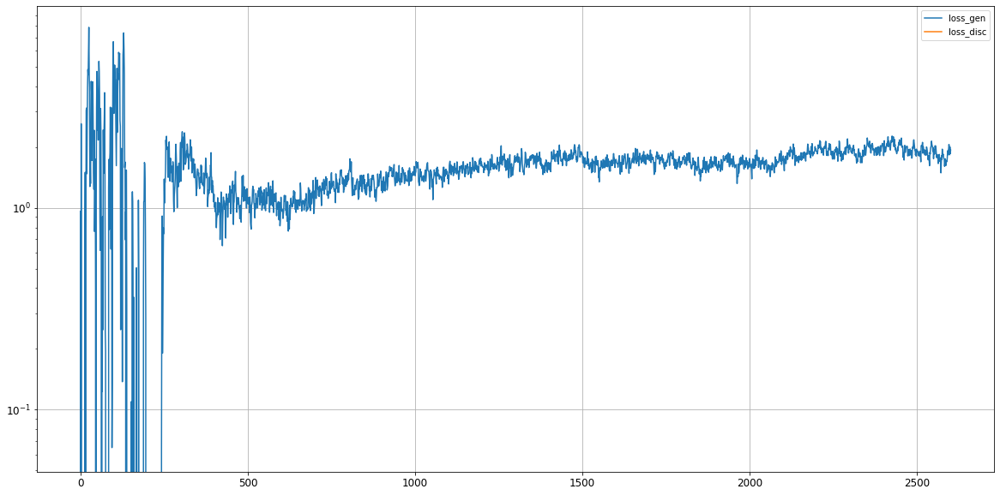

Epoch 2602/20000
discriminator loss:  -0.2435441 - generator loss:  1.8185163 - gradient penalty:  0.0036564 - 12s
Epoch 2603/20000
discriminator loss:  -0.2459081 - generator loss:  1.8517102 - gradient penalty:  0.0041974 - 12s
Epoch 2604/20000
discriminator loss:  -0.2350429 - generator loss:  1.9265369 - gradient penalty:  0.0036121 - 12s
Epoch 2605/20000
discriminator loss:  -0.2403274 - generator loss:  1.8233917 - gradient penalty:  0.0043387 - 12s
Epoch 2606/20000
discriminator loss:  -0.2352428 - generator loss:  1.6352714 - gradient penalty:  0.0032106 - 12s
Epoch 2607/20000
discriminator loss:  -0.2369808 - generator loss:  1.6792891 - gradient penalty:  0.0044067 - 12s
Epoch 2608/20000
discriminator loss:  -0.2291073 - generator loss:  1.7114781 - gradient penalty:  0.0042223 - 12s
Epoch 2609/20000
discriminator loss:  -0.2541976 - generator loss:  1.7370372 - gradient penalty:  0.0045969 - 12s
Epoch 2610/20000
discriminator loss:  -0.2400231 - generator loss:  1.7450826 - 

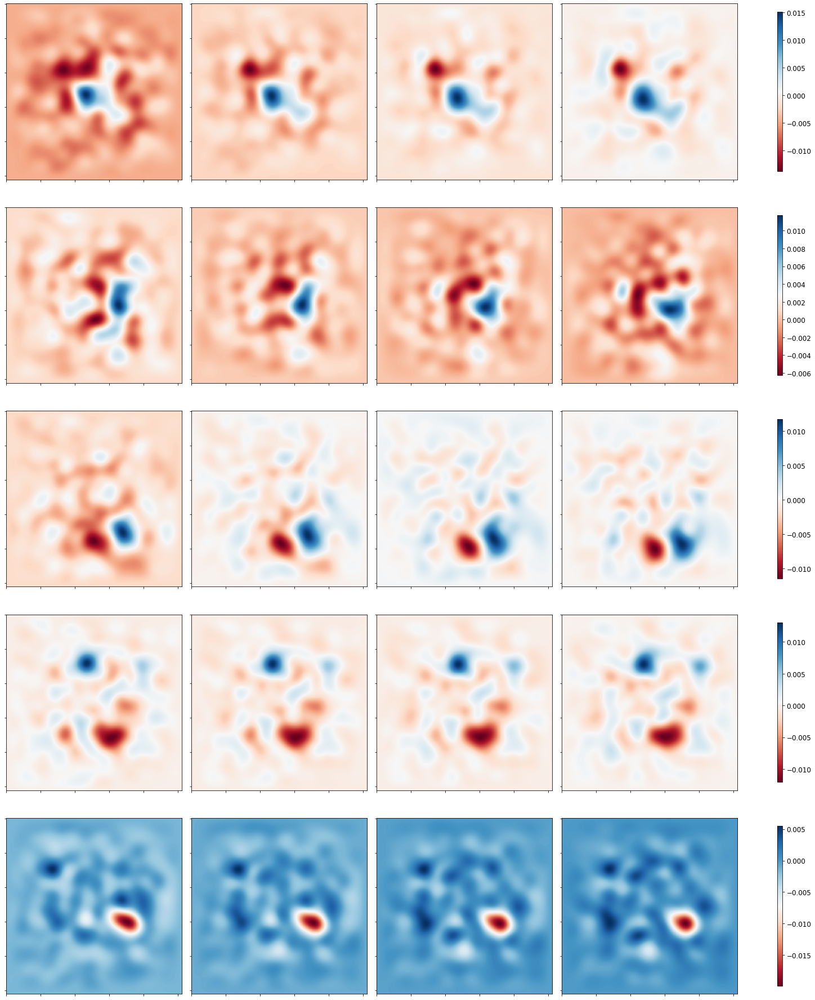

Loss: 


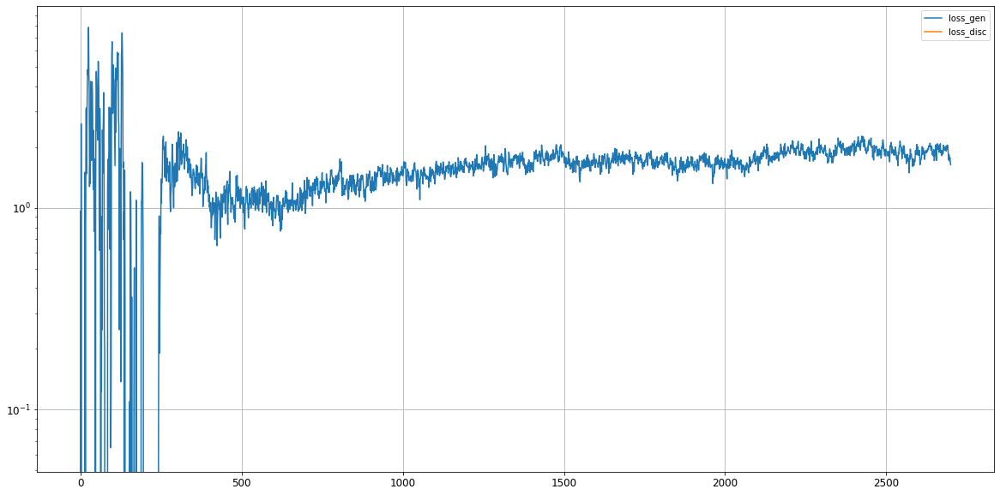

Epoch 2702/20000
discriminator loss:  -0.2476173 - generator loss:  1.7601235 - gradient penalty:  0.0035054 - 12s
Epoch 2703/20000
discriminator loss:  -0.2425568 - generator loss:  1.7875348 - gradient penalty:  0.0042307 - 12s
Epoch 2704/20000
discriminator loss:  -0.2549506 - generator loss:  1.8419684 - gradient penalty:  0.0033973 - 12s
Epoch 2705/20000
discriminator loss:  -0.2363646 - generator loss:  1.9759294 - gradient penalty:  0.0035594 - 12s
Epoch 2706/20000
discriminator loss:  -0.2258865 - generator loss:  1.9167296 - gradient penalty:  0.0040314 - 12s
Epoch 2707/20000
discriminator loss:  -0.2376332 - generator loss:  1.9346179 - gradient penalty:  0.0041000 - 12s
Epoch 2708/20000
discriminator loss:  -0.2366880 - generator loss:  1.9128872 - gradient penalty:  0.0026912 - 12s
Epoch 2709/20000
discriminator loss:  -0.2413224 - generator loss:  1.7405188 - gradient penalty:  0.0036122 - 12s
Epoch 2710/20000
discriminator loss:  -0.2428522 - generator loss:  1.7866715 - 

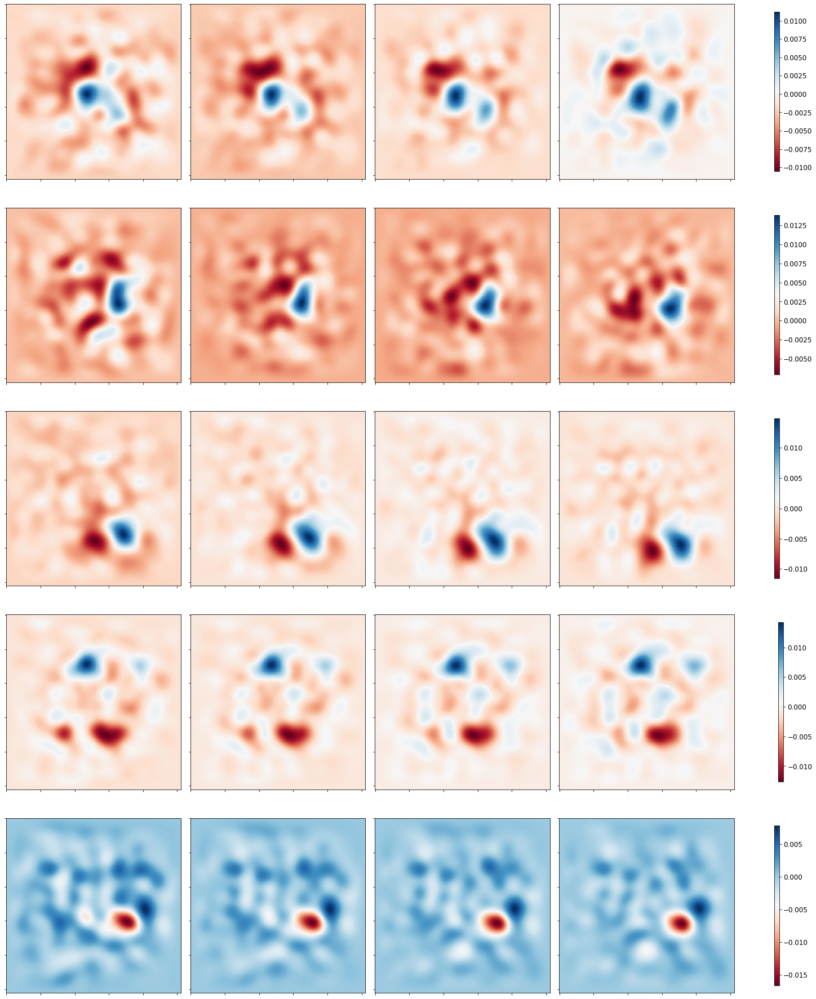

Loss: 


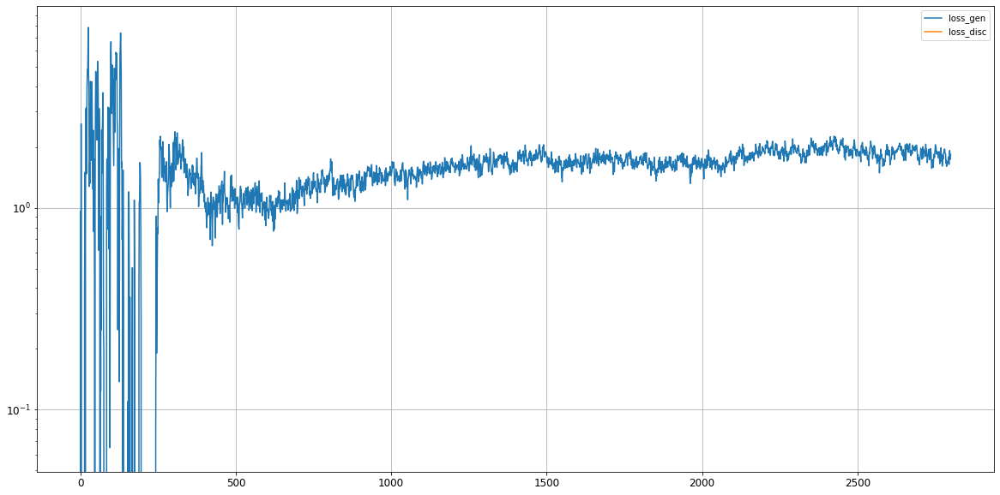

Epoch 2802/20000
discriminator loss:  -0.2371128 - generator loss:  1.9276485 - gradient penalty:  0.0035257 - 12s
Epoch 2803/20000
discriminator loss:  -0.2305064 - generator loss:  1.8578402 - gradient penalty:  0.0044135 - 12s
Epoch 2804/20000
discriminator loss:  -0.2391122 - generator loss:  1.7160872 - gradient penalty:  0.0042116 - 12s
Epoch 2805/20000
discriminator loss:  -0.2256669 - generator loss:  1.7015646 - gradient penalty:  0.0038193 - 12s
Epoch 2806/20000
discriminator loss:  -0.2334969 - generator loss:  1.7456844 - gradient penalty:  0.0038763 - 12s
Epoch 2807/20000
discriminator loss:  -0.2491069 - generator loss:  1.7782491 - gradient penalty:  0.0044308 - 12s
Epoch 2808/20000
discriminator loss:  -0.2383122 - generator loss:  1.7854645 - gradient penalty:  0.0051810 - 12s
Epoch 2809/20000
discriminator loss:  -0.2349464 - generator loss:  1.7822793 - gradient penalty:  0.0032823 - 12s
Epoch 2810/20000
discriminator loss:  -0.2378556 - generator loss:  1.6762996 - 

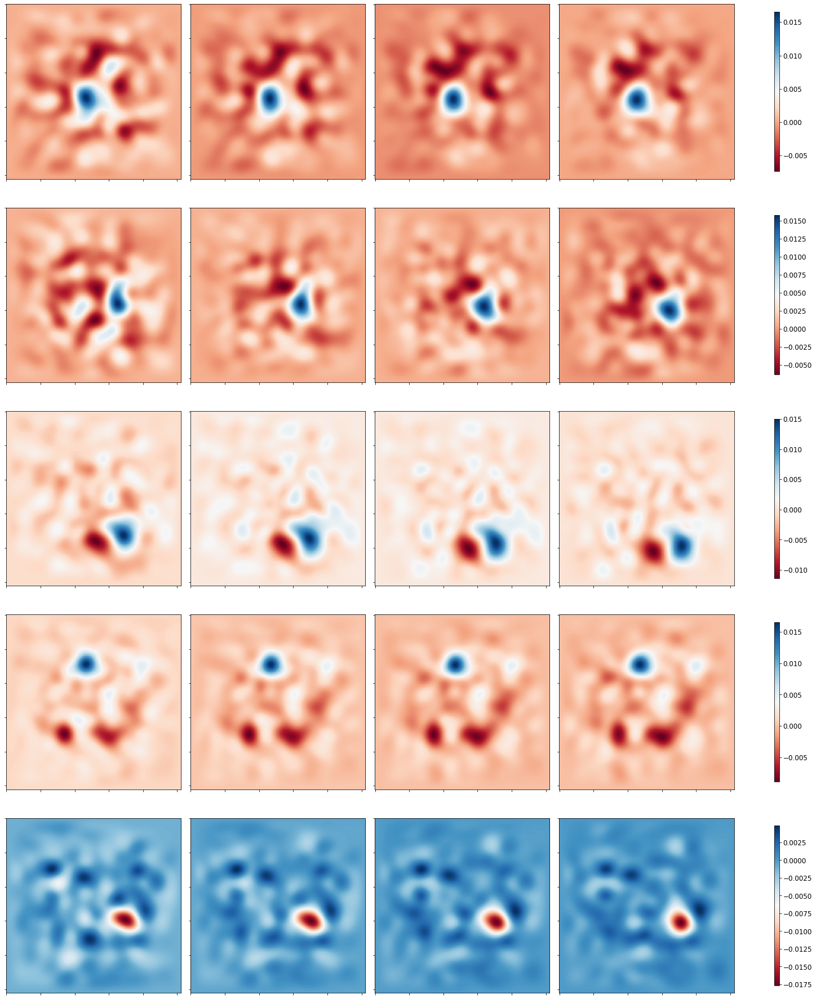

Loss: 


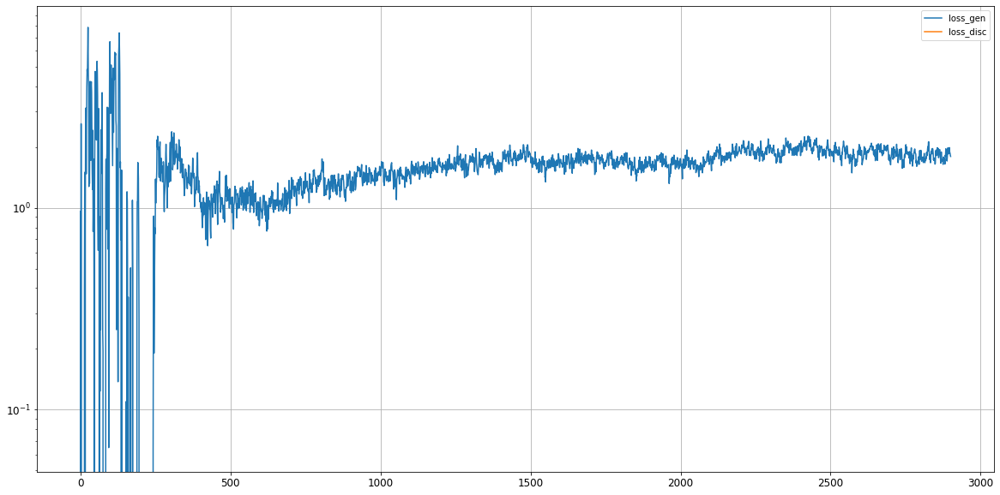

Epoch 2902/20000
discriminator loss:  -0.2298543 - generator loss:  1.8554906 - gradient penalty:  0.0039968 - 12s
Epoch 2903/20000
discriminator loss:  -0.2443844 - generator loss:  1.7295630 - gradient penalty:  0.0046033 - 12s
Epoch 2904/20000
discriminator loss:  -0.2346819 - generator loss:  1.8516960 - gradient penalty:  0.0048487 - 12s
Epoch 2905/20000
discriminator loss:  -0.2480501 - generator loss:  1.8400550 - gradient penalty:  0.0039265 - 12s
Epoch 2906/20000
discriminator loss:  -0.2327002 - generator loss:  1.8830826 - gradient penalty:  0.0038220 - 12s
Epoch 2907/20000
discriminator loss:  -0.2394982 - generator loss:  1.9665495 - gradient penalty:  0.0036536 - 12s
Epoch 2908/20000
discriminator loss:  -0.2310940 - generator loss:  2.0508044 - gradient penalty:  0.0041789 - 12s
Epoch 2909/20000
discriminator loss:  -0.2258602 - generator loss:  1.8087786 - gradient penalty:  0.0036538 - 12s
Epoch 2910/20000
discriminator loss:  -0.2448015 - generator loss:  1.7011683 - 

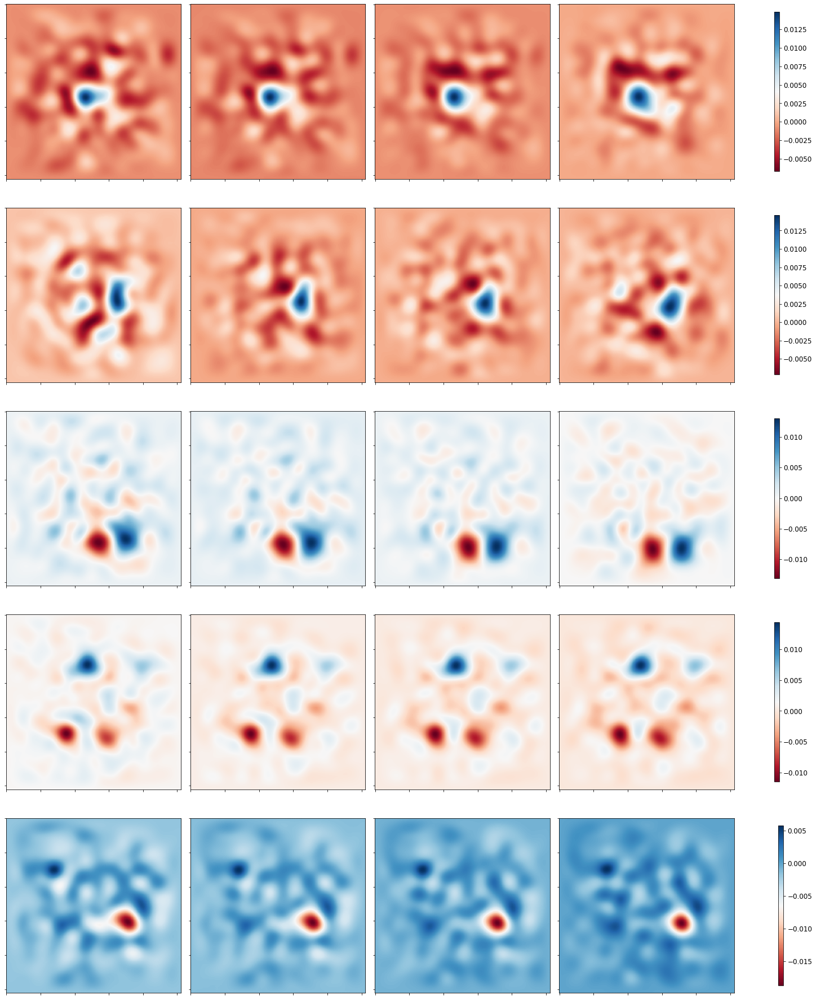

Loss: 


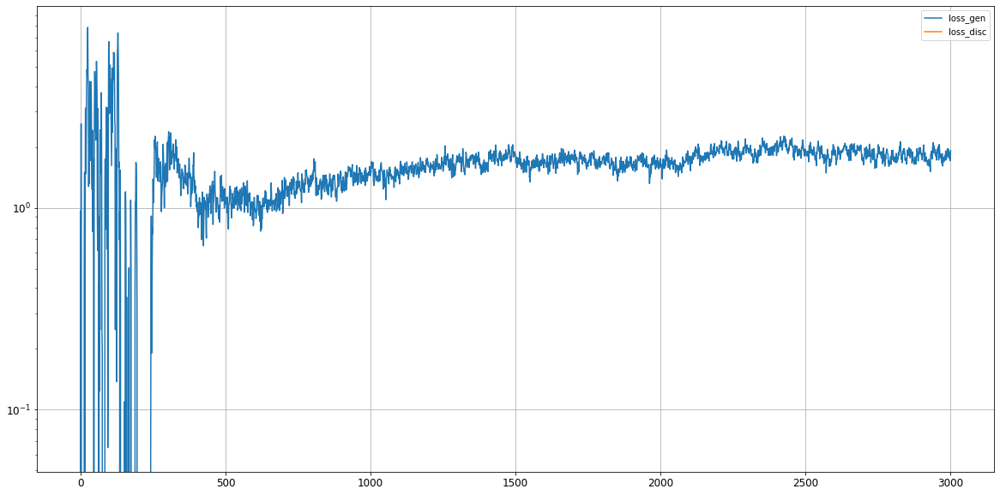

Epoch 3002/20000
discriminator loss:  -0.2336317 - generator loss:  2.0270548 - gradient penalty:  0.0042360 - 12s
Epoch 3003/20000
discriminator loss:  -0.2304043 - generator loss:  2.0828600 - gradient penalty:  0.0037202 - 12s
Epoch 3004/20000
discriminator loss:  -0.2354976 - generator loss:  2.0417519 - gradient penalty:  0.0044007 - 12s
Epoch 3005/20000
discriminator loss:  -0.2290463 - generator loss:  2.0740268 - gradient penalty:  0.0046457 - 12s
Epoch 3006/20000
discriminator loss:  -0.2353690 - generator loss:  1.9852484 - gradient penalty:  0.0032872 - 12s
Epoch 3007/20000
discriminator loss:  -0.2436877 - generator loss:  1.8838285 - gradient penalty:  0.0043597 - 21s
Epoch 3008/20000
discriminator loss:  -0.2471875 - generator loss:  1.7704929 - gradient penalty:  0.0039822 - 12s
Epoch 3009/20000
discriminator loss:  -0.2255835 - generator loss:  1.9483078 - gradient penalty:  0.0036242 - 12s
Epoch 3010/20000
discriminator loss:  -0.2285535 - generator loss:  1.8519892 - 

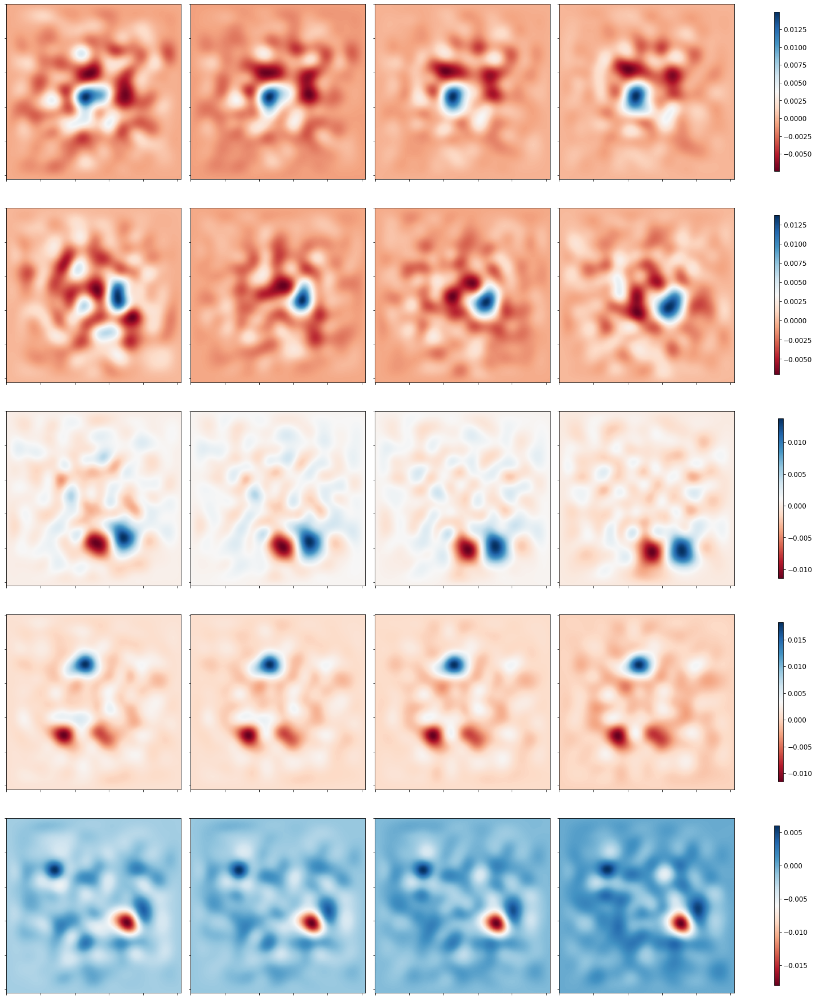

Loss: 


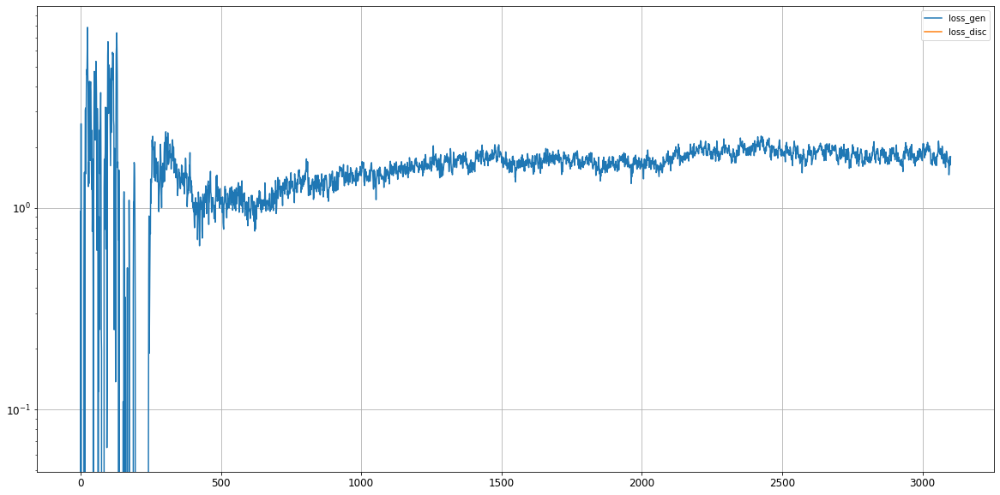

Epoch 3102/20000
discriminator loss:  -0.2375363 - generator loss:  1.9298141 - gradient penalty:  0.0042598 - 12s
Epoch 3103/20000
discriminator loss:  -0.2395470 - generator loss:  2.0650854 - gradient penalty:  0.0033803 - 12s
Epoch 3104/20000
discriminator loss:  -0.2309013 - generator loss:  1.9192286 - gradient penalty:  0.0038392 - 12s
Epoch 3105/20000
discriminator loss:  -0.2295273 - generator loss:  1.8020911 - gradient penalty:  0.0043539 - 12s
Epoch 3106/20000
discriminator loss:  -0.2314762 - generator loss:  1.6559274 - gradient penalty:  0.0040096 - 12s
Epoch 3107/20000
discriminator loss:  -0.2254753 - generator loss:  1.5968280 - gradient penalty:  0.0037641 - 12s
Epoch 3108/20000
discriminator loss:  -0.2281721 - generator loss:  1.6568162 - gradient penalty:  0.0035383 - 12s
Epoch 3109/20000
discriminator loss:  -0.2280931 - generator loss:  1.7395175 - gradient penalty:  0.0036193 - 12s
Epoch 3110/20000
discriminator loss:  -0.2413457 - generator loss:  1.8378336 - 

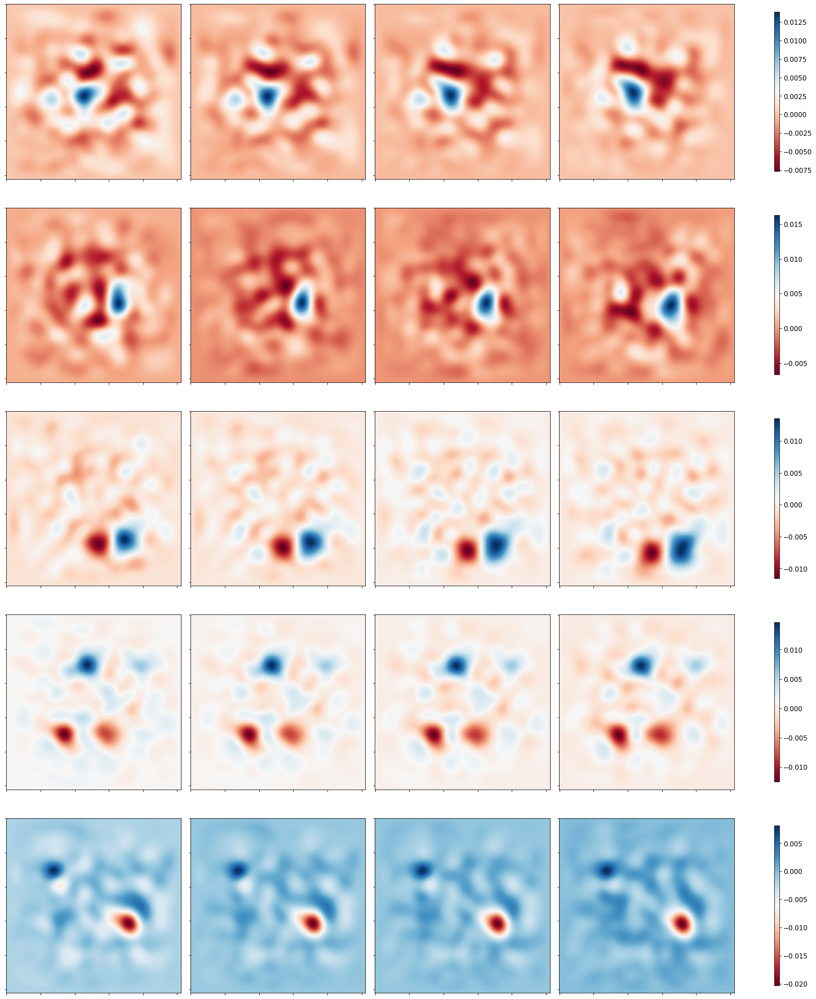

Loss: 


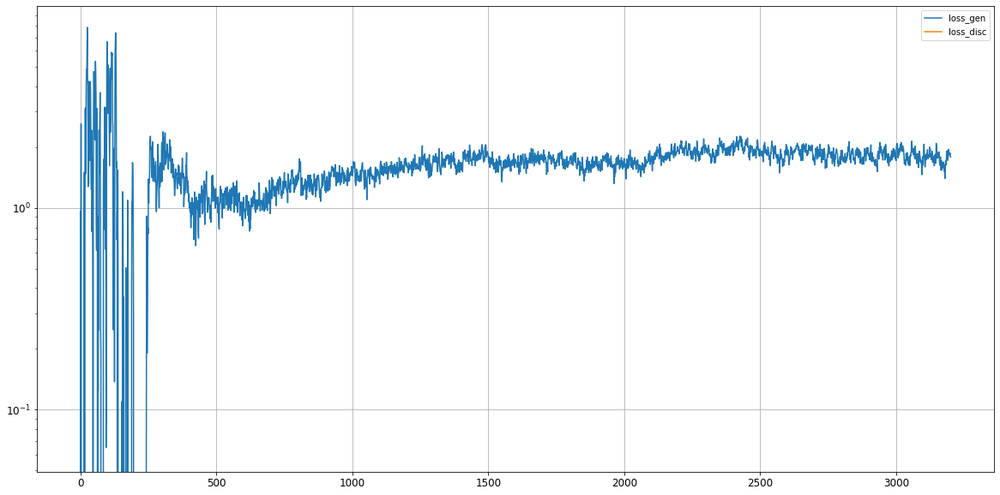

Epoch 3202/20000
discriminator loss:  -0.2396842 - generator loss:  1.8090227 - gradient penalty:  0.0033468 - 12s
Epoch 3203/20000
discriminator loss:  -0.2352677 - generator loss:  1.8255599 - gradient penalty:  0.0039505 - 12s
Epoch 3204/20000
discriminator loss:  -0.2196375 - generator loss:  1.7477781 - gradient penalty:  0.0033425 - 12s
Epoch 3205/20000
discriminator loss:  -0.2321158 - generator loss:  1.7469667 - gradient penalty:  0.0037018 - 12s
Epoch 3206/20000
discriminator loss:  -0.2306524 - generator loss:  1.7185409 - gradient penalty:  0.0027873 - 12s
Epoch 3207/20000
discriminator loss:  -0.2293806 - generator loss:  1.7026359 - gradient penalty:  0.0032387 - 21s
Epoch 3208/20000
discriminator loss:  -0.2371222 - generator loss:  1.8198456 - gradient penalty:  0.0051813 - 12s
Epoch 3209/20000
discriminator loss:  -0.2225543 - generator loss:  1.6554235 - gradient penalty:  0.0038374 - 12s
Epoch 3210/20000
discriminator loss:  -0.2300684 - generator loss:  1.8689241 - 

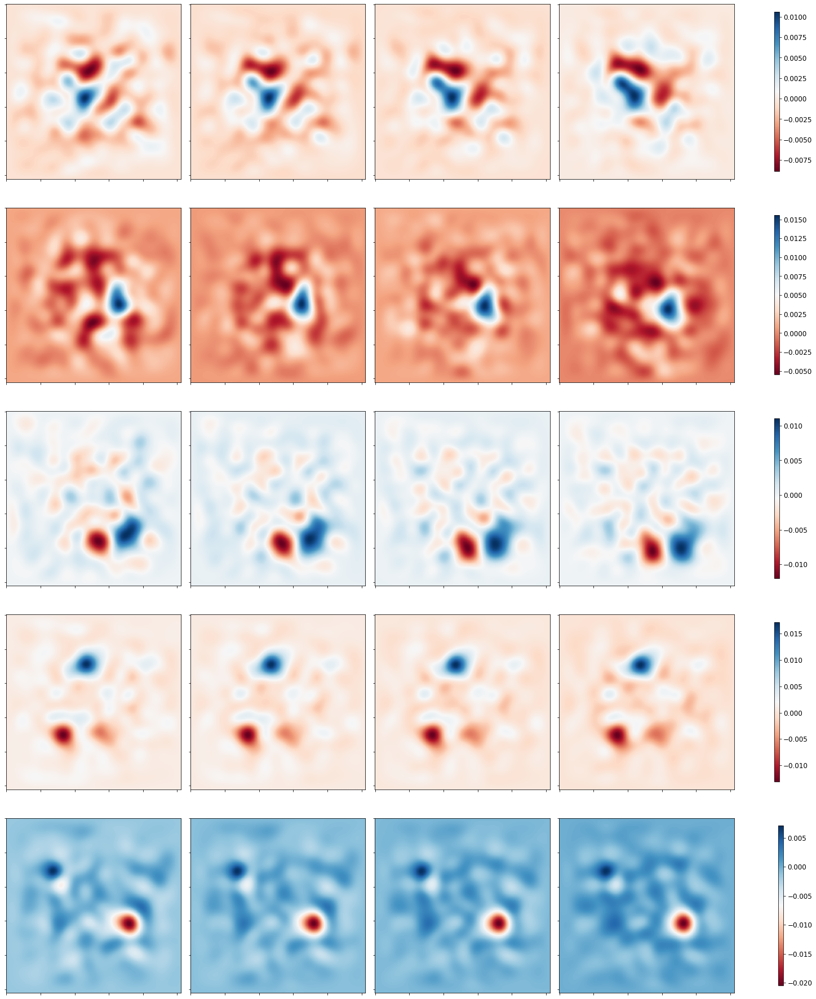

Loss: 


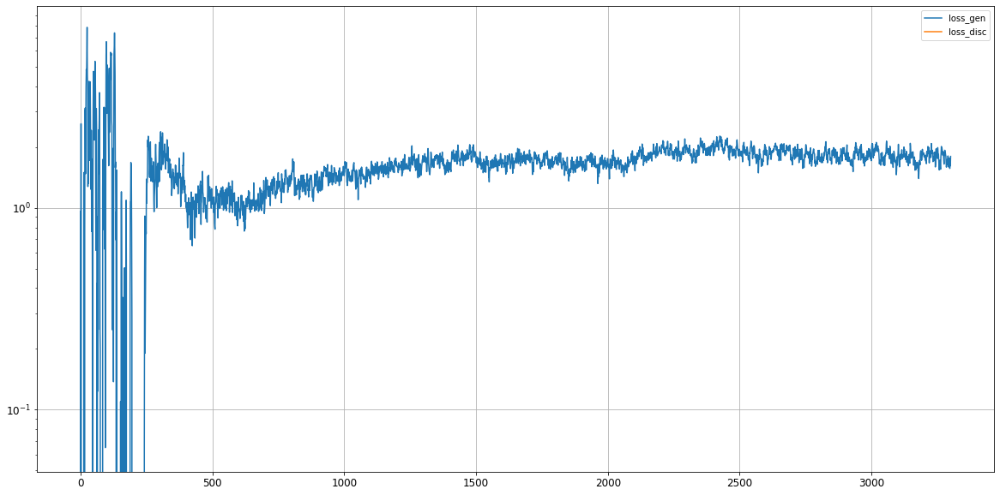

Epoch 3302/20000
discriminator loss:  -0.2384193 - generator loss:  1.7374743 - gradient penalty:  0.0036606 - 12s
Epoch 3303/20000
discriminator loss:  -0.2306168 - generator loss:  1.6899191 - gradient penalty:  0.0032915 - 12s
Epoch 3304/20000
discriminator loss:  -0.2224369 - generator loss:  1.5466549 - gradient penalty:  0.0032368 - 12s
Epoch 3305/20000
discriminator loss:  -0.2250188 - generator loss:  1.6527766 - gradient penalty:  0.0037783 - 12s
Epoch 3306/20000
discriminator loss:  -0.2285223 - generator loss:  1.7185657 - gradient penalty:  0.0044504 - 12s
Epoch 3307/20000
discriminator loss:  -0.2369829 - generator loss:  1.7822677 - gradient penalty:  0.0034942 - 12s
Epoch 3308/20000
discriminator loss:  -0.2313331 - generator loss:  1.8140950 - gradient penalty:  0.0038874 - 12s
Epoch 3309/20000
discriminator loss:  -0.2317738 - generator loss:  1.6592126 - gradient penalty:  0.0047440 - 12s
Epoch 3310/20000
discriminator loss:  -0.2242354 - generator loss:  1.6346468 - 

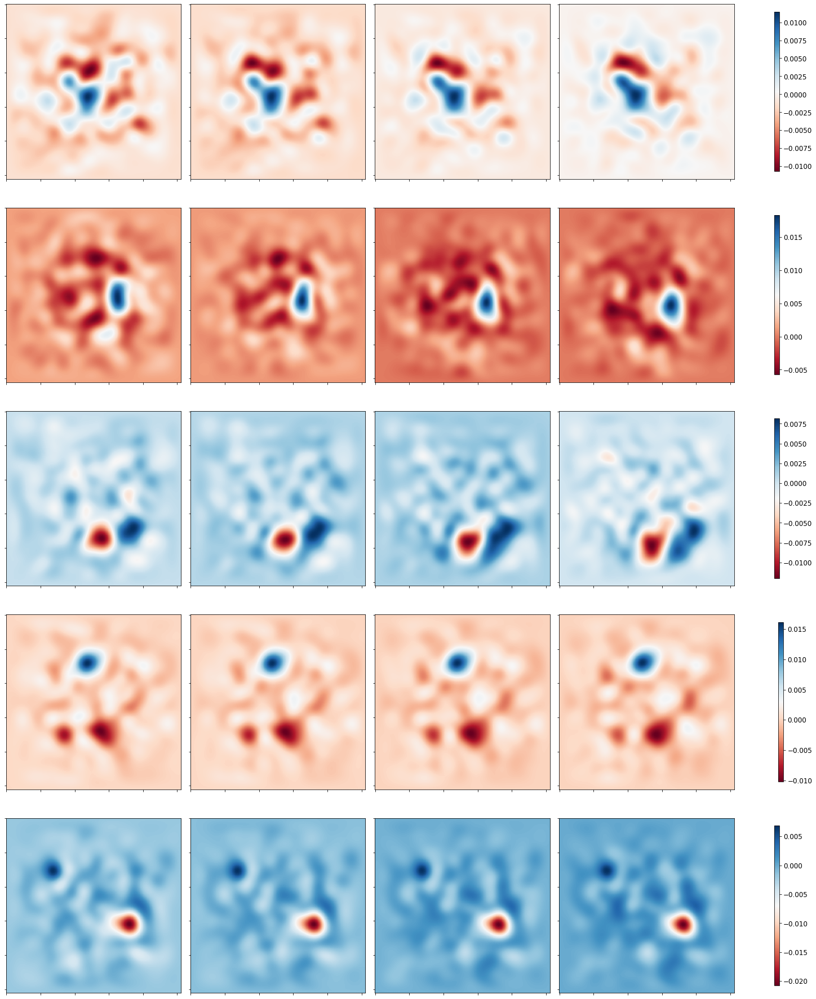

Loss: 


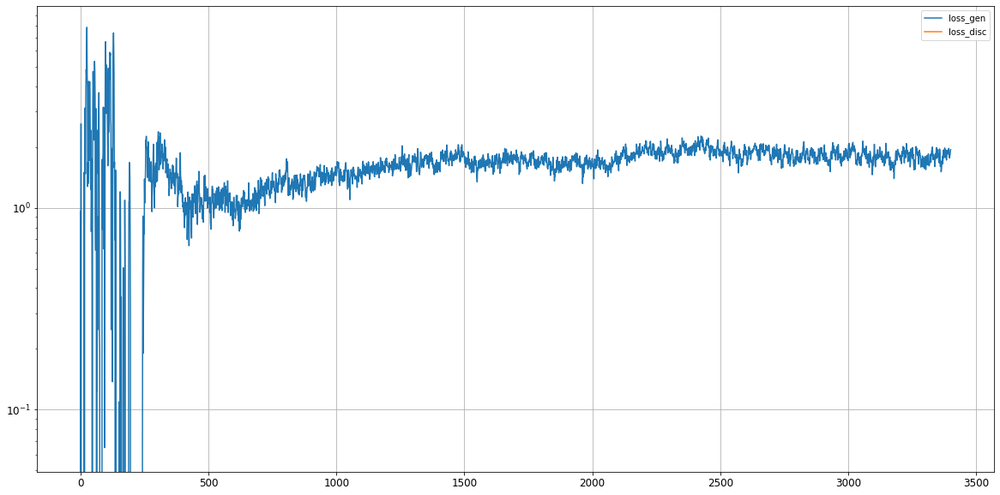

Epoch 3402/20000
discriminator loss:  -0.2225169 - generator loss:  1.8575908 - gradient penalty:  0.0033567 - 12s
Epoch 3403/20000
discriminator loss:  -0.2266675 - generator loss:  2.0543501 - gradient penalty:  0.0030929 - 12s
Epoch 3404/20000
discriminator loss:  -0.2263716 - generator loss:  1.9205544 - gradient penalty:  0.0042792 - 12s
Epoch 3405/20000
discriminator loss:  -0.2182233 - generator loss:  1.8663367 - gradient penalty:  0.0029600 - 12s
Epoch 3406/20000
discriminator loss:  -0.2274756 - generator loss:  2.0006456 - gradient penalty:  0.0031282 - 12s
Epoch 3407/20000
discriminator loss:  -0.2219204 - generator loss:  1.9765944 - gradient penalty:  0.0038633 - 12s
Epoch 3408/20000
discriminator loss:  -0.2193455 - generator loss:  1.8824141 - gradient penalty:  0.0047663 - 12s
Epoch 3409/20000
discriminator loss:  -0.2312724 - generator loss:  1.9784119 - gradient penalty:  0.0034874 - 12s
Epoch 3410/20000
discriminator loss:  -0.2302437 - generator loss:  1.9535067 - 

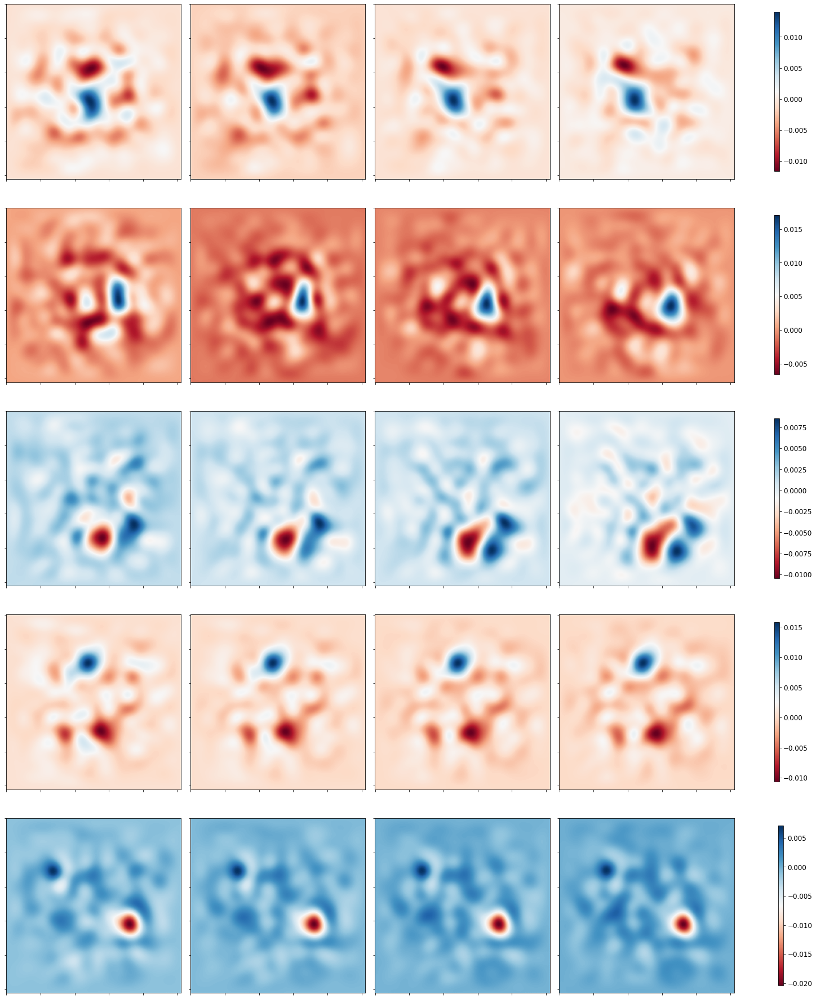

Loss: 


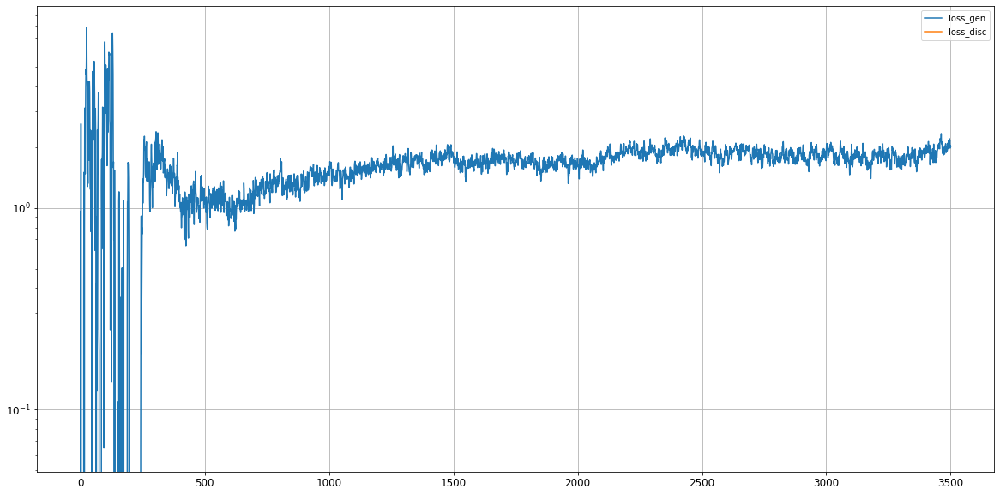

Epoch 3502/20000
discriminator loss:  -0.2211832 - generator loss:  2.0038002 - gradient penalty:  0.0037560 - 12s
Epoch 3503/20000
discriminator loss:  -0.2258201 - generator loss:  2.1178274 - gradient penalty:  0.0035715 - 12s
Epoch 3504/20000
discriminator loss:  -0.2247475 - generator loss:  2.0614991 - gradient penalty:  0.0037974 - 12s
Epoch 3505/20000
discriminator loss:  -0.2209913 - generator loss:  2.0307708 - gradient penalty:  0.0054144 - 12s
Epoch 3506/20000
discriminator loss:  -0.2338984 - generator loss:  1.9545593 - gradient penalty:  0.0043222 - 12s
Epoch 3507/20000
discriminator loss:  -0.2247019 - generator loss:  2.0664971 - gradient penalty:  0.0044596 - 12s
Epoch 3508/20000
discriminator loss:  -0.2155376 - generator loss:  2.1866267 - gradient penalty:  0.0031845 - 12s
Epoch 3509/20000
discriminator loss:  -0.2227972 - generator loss:  2.1548800 - gradient penalty:  0.0035165 - 12s
Epoch 3510/20000
discriminator loss:  -0.2246166 - generator loss:  1.9979730 - 

In [ ]:
import time
hist = train(train_dataset, epochs=20000, n_critic=5) #resume training from 5000

### DCGAN 

1. (original architecture with diff LR: disc=1e-4, gen=5e-5) **still collapses**
2. More latent space, 64 batch size, equal LR. **still collapses**
3. 3000 latent space, 7 consecutive times for the GAN, 5 step gap between times

Generator Model

In [ ]:
def make_generator_model():
    # model = tf.keras.Sequential()
    # model.add(keras.layers.Dense(5*73*256, use_bias=False, input_shape=(latent_space,)))
    # model.add(keras.layers.BatchNormalization())
    # model.add(keras.layers.LeakyReLU())

    # model.add(keras.layers.Reshape((5, 73, 256)))

    # model.add(keras.layers.Conv2DTranspose(128, (3, 3), strides=(1, 1), padding='same', use_bias=False))
    # model.add(keras.layers.BatchNormalization())
    # model.add(keras.layers.LeakyReLU())

    # model.add(keras.layers.Conv2DTranspose(64, (3, 3), strides=(2, 2), padding='same', use_bias=False))
    # model.add(keras.layers.BatchNormalization())
    # model.add(keras.layers.LeakyReLU())

    # model.add(keras.layers.Conv2DTranspose(1, (3, 3), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.Dense(5*12*512, use_bias=False, input_shape=(latent_space,)))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU())

    model.add(tf.keras.layers.Reshape((5, 12, 512)))

    model.add(tf.keras.layers.Conv2DTranspose(256, (3, 7), strides=(1, 1), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU()) 

    model.add(tf.keras.layers.Conv2DTranspose(128, (3, 7), strides=(1, 2), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU())

    model.add(tf.keras.layers.Conv2DTranspose(64, (3, 7), strides=(1, 2), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU())

    model.add(tf.keras.layers.Conv2DTranspose(32, (3, 7), strides=(1, 2), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU())

    model.add(tf.keras.layers.Conv2DTranspose(1, (3, 7), strides=(1, 3), padding ='valid', output_padding=[0,0], use_bias=False, activation='tanh'))

    return model
generator = make_generator_model()
generator.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 30720)             92160000  
_________________________________________________________________
batch_normalization_5 (Batch (None, 30720)             122880    
_________________________________________________________________
leaky_re_lu_5 (LeakyReLU)    (None, 30720)             0         
_________________________________________________________________
reshape_1 (Reshape)          (None, 5, 12, 512)        0         
_________________________________________________________________
conv2d_transpose_5 (Conv2DTr (None, 5, 12, 256)        2752512   
_________________________________________________________________
batch_normalization_6 (Batch (None, 5, 12, 256)        1024      
_________________________________________________________________
leaky_re_lu_6 (LeakyReLU)    (None, 5, 12, 256)       

Testing the model generator

(1, 7, 292, 1)
(7, 65536)


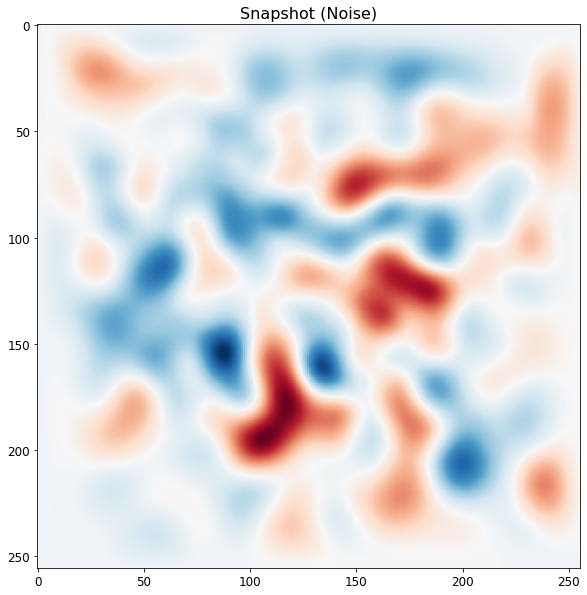

In [ ]:
noise = tf.random.normal([1, latent_space])
generated_image = generator(noise, training=False)
print(generated_image.shape)

fig, ax = plt.subplots(figsize=[10,10])
inv_generated_image = invert_data(generated_image[0, :, :, 0])
print(inv_generated_image.shape)
ax.imshow(inv_generated_image[0, :].reshape(nx, nx), cmap='RdBu');
ax.set_title('Snapshot (Noise)', fontsize=16);

Discriminator

In [ ]:
def make_discriminator_model():
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.Conv2D(64, (3, 3), strides=(2, 2), padding='same',
                                     input_shape=[ntimes, num_of_coeff, 1]))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(256, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(256, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(1))

    return model
discriminator = make_discriminator_model()
discriminator.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 4, 146, 64)        640       
_________________________________________________________________
leaky_re_lu_10 (LeakyReLU)   (None, 4, 146, 64)        0         
_________________________________________________________________
dropout (Dropout)            (None, 4, 146, 64)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 2, 73, 64)         102464    
_________________________________________________________________
leaky_re_lu_11 (LeakyReLU)   (None, 2, 73, 64)         0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 2, 73, 64)         0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 1, 37, 128)       

Test disciriminator model

In [ ]:
decision = discriminator(generated_image)
print(decision)

tf.Tensor([[-2.5051228e-05]], shape=(1, 1), dtype=float32)


Generative Model


In [ ]:
gan = tf.keras.models.Sequential ([generator, discriminator])

Cost Function and Optimization

In [ ]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(real_output, fake_output):
  real_loss = cross_entropy(tf.ones_like(real_output), real_output)
  fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
  total_loss = real_loss + fake_loss
  return total_loss

def generator_loss(fake_output):
  fake_loss = cross_entropy(tf.ones_like(fake_output), fake_output)
  return fake_loss

generator_mean_loss = tf.keras.metrics.Mean(dtype=tf.float32)
discriminator_mean_loss = tf.keras.metrics.Mean(dtype=tf.float32)

# Optimizers for generator and optimizer models

generator_optimizer = tf.keras.optimizers.Adam(g_lr)
discriminator_optimizer = tf.keras.optimizers.Adam(d_lr)


In [ ]:
# logs to document losses
version_num = 'E3000_16b'
# generator_log_dir = SAVE_DIR + 'logs/generator_v' + str(version_num) + '_'+ str(num_of_coeff)
# discriminator_log_dir = SAVE_DIR + 'logs/discriminator_v' + str(version_num) + '_'+ str(num_of_coeff)
# gen_summary = tf.summary.create_file_writer(generator_log_dir)
# disc_summary = tf.summary.create_file_writer(discriminator_log_dir)


print('Version no.: ', version_num)
print('POD coeffiecients: ', num_of_coeff)
print('Batch size: ', BATCH_SIZE)
print('Learning Rate: gen-', g_lr, ', disc-', d_lr)
print('Instances: ', ntimes)
print('Time steps: ', step)

Version no.:  E3000_16b
POD coeffiecients:  292
Batch size:  16
Learning Rate: gen- 0.0001 , disc- 0.0001


Training step

In [ ]:
@tf.function
def train_step(batch):
    noise = tf.random.normal([BATCH_SIZE, latent_space])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)
        real_output = discriminator(batch, training=True)
        fake_output = discriminator(generated_images, training=True)

        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
    
    generator_mean_loss(gen_loss)
    discriminator_mean_loss(disc_loss)

Train GAN - Training loop

In [ ]:
def train(dataset, epochs):
    hist = []
    for epoch in range(epochs+1):
        start = time.time()
        print("Epoch {}/{}".format(epoch + 1, epochs))   

        for batch in dataset:
            train_step(batch)
            
        # with gen_summary.as_default():
        #     tf.summary.scalar('loss', generator_mean_loss.result(), step=epoch)

        # with disc_summary.as_default():
        #     tf.summary.scalar('loss', discriminator_mean_loss.result(), step=epoch)
        
        hist.append([generator_mean_loss.result().numpy(), discriminator_mean_loss.result().numpy()])

        generator_mean_loss.reset_states()
        discriminator_mean_loss.reset_states()
        print("discriminator loss: ", "{:.6f}".format(hist[-1][1]), end=' - ')
        print("generator loss: ", "{:.6f}".format(hist[-1][0]), end=' - ')    
        print ('{:.0f}s'.format( time.time()-start))

        pred_time_len = 4
        # Global variables are used below
        if epoch%100 == 0: 
            # Plot generated data
            X_generated = generator.predict(seed).reshape(-1, num_of_coeff)
            X_generated = invert_data(X_generated)
            print(X_generated.shape)
            X_generated = X_generated.reshape(num_examples_to_generate, ntimes, nx, nx)
            fig, ax = plt.subplots(5, pred_time_len, figsize=[20, 25], constrained_layout=True)
            for j in range(5):
              for i in range(pred_time_len):
                im = ax.flatten()[i + (pred_time_len*j)].imshow(X_generated[j][i,:,:], cmap='RdBu')
                ax[j,i].set_xticklabels([]), ax[j,i].set_yticklabels([])
              fig.colorbar(im, ax=ax[j,:], location='right', shrink=0.8, pad=0.05)
            plt.show() 
                    
            
            # plot loss
            print('Loss: ')
            fig, ax = plt.subplots(1,1, figsize=[20,10])
            ax.plot(hist)
            ax.legend(['loss_gen', 'loss_disc'])
            ax.set_yscale('log')
            ax.grid()
            plt.show()
        if epoch%1000 == 0:
          # Save model once greater that 10,000 iterations 
            gan.save(SAVE_DIR + 'ganmodels/model_v'+ str(version_num) + '_'+ 
                                        str(num_of_coeff)+'_'+str(epoch)+'.h5')  
            
    return hist


In [ ]:
import time
hist = train(train_dataset, epochs=50000)

### Unrolled DCGAN 

Generator Model

In [ ]:
def make_generator_model():
    # model = tf.keras.Sequential()
    # model.add(keras.layers.Dense(5*73*256, use_bias=False, input_shape=(latent_space,)))
    # model.add(keras.layers.BatchNormalization())
    # model.add(keras.layers.LeakyReLU())

    # model.add(keras.layers.Reshape((5, 73, 256)))

    # model.add(keras.layers.Conv2DTranspose(128, (3, 3), strides=(1, 1), padding='same', use_bias=False))
    # model.add(keras.layers.BatchNormalization())
    # model.add(keras.layers.LeakyReLU())

    # model.add(keras.layers.Conv2DTranspose(64, (3, 3), strides=(2, 2), padding='same', use_bias=False))
    # model.add(keras.layers.BatchNormalization())
    # model.add(keras.layers.LeakyReLU())

    # model.add(keras.layers.Conv2DTranspose(1, (3, 3), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
    
    #alt architecture
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.Dense(5*12*512, use_bias=False, input_shape=(latent_space,)))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.3))
  

    model.add(tf.keras.layers.Reshape((5, 12, 512)))

    model.add(tf.keras.layers.Conv2DTranspose(256, (3, 7), strides=(1, 1), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.3)) 

    model.add(tf.keras.layers.Conv2DTranspose(128, (3, 7), strides=(1, 2), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.3))

    model.add(tf.keras.layers.Conv2DTranspose(64, (3, 7), strides=(1, 2), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.3))

    model.add(tf.keras.layers.Conv2DTranspose(32, (3, 7), strides=(1, 2), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.3))


    model.add(tf.keras.layers.Conv2DTranspose(1, (3, 7), strides=(1, 3), padding ='valid', output_padding=[0,0], use_bias=False, activation='tanh'))

    return model
generator = make_generator_model()
generator.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 30720)             92160000  
_________________________________________________________________
batch_normalization_3 (Batch (None, 30720)             122880    
_________________________________________________________________
leaky_re_lu_3 (LeakyReLU)    (None, 30720)             0         
_________________________________________________________________
reshape_1 (Reshape)          (None, 5, 12, 512)        0         
_________________________________________________________________
conv2d_transpose_3 (Conv2DTr (None, 5, 12, 256)        2752512   
_________________________________________________________________
batch_normalization_4 (Batch (None, 5, 12, 256)        1024      
_________________________________________________________________
leaky_re_lu_4 (LeakyReLU)    (None, 5, 12, 256)       

Testing the model generator

(1, 7, 292, 1)
(7, 65536)


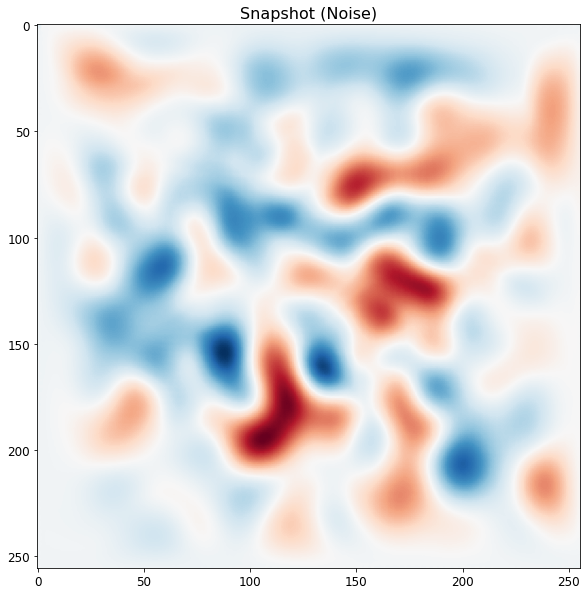

In [ ]:
noise = tf.random.normal([1, latent_space])
generated_image = generator(noise, training=False)
print(generated_image.shape)

fig, ax = plt.subplots(figsize=[10,10])
inv_generated_image = invert_data(generated_image[0, :, :, 0])
print(inv_generated_image.shape)
ax.imshow(inv_generated_image[0, :].reshape(nx, nx), cmap='RdBu');
ax.set_title('Snapshot (Noise)', fontsize=16);

Discriminator

In [ ]:

def make_discriminator_model():

    model = tf.keras.Sequential()
    model.add(tf.keras.layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same',
                                     input_shape=[ntimes, num_of_coeff, 1]))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(256, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(256, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(1))

    return model
discriminator = make_discriminator_model()
discriminator.summary()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 4, 146, 64)        1664      
_________________________________________________________________
leaky_re_lu_8 (LeakyReLU)    (None, 4, 146, 64)        0         
_________________________________________________________________
dropout (Dropout)            (None, 4, 146, 64)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 2, 73, 64)         102464    
_________________________________________________________________
leaky_re_lu_9 (LeakyReLU)    (None, 2, 73, 64)         0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 2, 73, 64)         0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 1, 37, 128)       

Test disciriminator model

In [ ]:
decision = discriminator(generated_image)
print(decision)

tf.Tensor([[1.818499e-05]], shape=(1, 1), dtype=float32)


Generative Model


In [ ]:
gan = tf.keras.models.Sequential ([generator, discriminator])

Cost Function and Optimization

In [ ]:
from collections import OrderedDict
_graph_replace = tf.contrib.graph_editor.graph_replace

def remove_original_op_attributes(graph):
    """Remove _original_op attribute from all operations in a graph."""
    for op in graph.get_operations():
        op._original_op = None
        
def graph_replace(*args, **kwargs):
    """Monkey patch graph_replace so that it works with TF 1.0"""
    remove_original_op_attributes(tf.get_default_graph())
    return _graph_replace(*args, **kwargs)

TensorFlow is already loaded. Please restart the runtime to change versions.


AttributeError: ignored

In [ ]:
def extract_update_dict(update_ops):
    """Extract variables and their new values from Assign and AssignAdd ops.
    
    Args:
        update_ops: list of Assign and AssignAdd ops, typically computed using Keras' opt.get_updates()

    Returns:
        dict mapping from variable values to their updated value
    """
    name_to_var = {v.name: v for v in tf.global_variables()}
    updates = OrderedDict()
    for update in update_ops:
        var_name = update.op.inputs[0].name
        var = name_to_var[var_name]
        value = update.op.inputs[1]
        if update.op.type == 'Assign':
            updates[var.value()] = value
        elif update.op.type == 'AssignAdd':
            updates[var.value()] = var + value
        else:
            raise ValueError("Update op type (%s) must be of type Assign or AssignAdd"%update_op.op.type)
    return updates

In [ ]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(real_output, fake_output):
  real_loss = cross_entropy(tf.ones_like(real_output), real_output)
  fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
  total_loss = real_loss + fake_loss
  return total_loss

def generator_loss(disc_loss, disc_updates, unrolled_steps):

  # update_dict contains a dictionary mapping from variables (\theta_D^0)
  # to their values after one step of optimization (\theta_D^1)
  update_dict = extract_update_dict(disc_updates)
  cur_update_dict = update_dict
  for i in xrange(unrolled_steps-1):
    # Compute variable updates given the previous iteration's updated variable
    cur_update_dict = graph_replace(update_dict, cur_update_dict)
  # Final unrolled loss uses the parameters at the last time step
  fake_loss = graph_replace(disc_loss, cur_update_dict)
  return fake_loss

generator_mean_loss = tf.keras.metrics.Mean(dtype=tf.float32)
discriminator_mean_loss = tf.keras.metrics.Mean(dtype=tf.float32)

# Optimizers for generator and optimizer models

generator_optimizer = tf.keras.optimizers.Adam(learning_rate=g_lr)
discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=d_lr)


In [ ]:
# logs to document losses
version_num = 'E3000_16b_UGAN'
# generator_log_dir = SAVE_DIR + 'logs/generator_v' + str(version_num) + '_'+ str(num_of_coeff)
# discriminator_log_dir = SAVE_DIR + 'logs/discriminator_v' + str(version_num) + '_'+ str(num_of_coeff)
# gen_summary = tf.summary.create_file_writer(generator_log_dir)
# disc_summary = tf.summary.create_file_writer(discriminator_log_dir)


print('Version no.: ', version_num)
print('POD coeffiecients: ', num_of_coeff)
print('Batch size: ', BATCH_SIZE)
print('Learning Rate: ', g_lr, '(gen),', d_lr, '(disc)')
print('Instances: ', ntimes)
print('Time steps: ', step)

Version no.:  E3000_16b_UGAN
POD coeffiecients:  292
Batch size:  16
Learning Rate:  0.0001 (gen), 0.0001 (disc)
Instances:  7
Time steps:  5


Training step

In [ ]:
@tf.function
def train_step(batch, unrolled_steps):
    noise = tf.random.normal([BATCH_SIZE, latent_space])

    # Discriminator training 
    with tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)
        real_output = discriminator(batch, training=True)
        fake_output = discriminator(generated_images, training=True)

        disc_loss = discriminator_loss(real_output, fake_output)
      
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
    discriminator_mean_loss(disc_loss)
    
    # Generator training
    with tf.GradientTape() as gen_tape:
        # Unrolled Loss (applies to generator)
        gen_unrolled_loss = generator_loss(disc_loss, gradients_of_discriminator, unrolled_steps)

    gradients_of_generator = gen_tape.gradient(-gen_unrolled_loss, generator.trainable_variables)
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    generator_mean_loss(gen_unrolled_loss)

Training loop

In [ ]:
def train(dataset, epochs, unrolled_steps):
    hist = []
    for epoch in range(epochs+1):
        start = time.time()
        print("Epoch {}/{}".format(epoch + 1, epochs))   

        for batch in dataset:
            train_step(batch, unrolled_steps)
            
        # with gen_summary.as_default():
        #     tf.summary.scalar('loss', generator_mean_loss.result(), step=epoch)

        # with disc_summary.as_default():
        #     tf.summary.scalar('loss', discriminator_mean_loss.result(), step=epoch)
        
        hist.append([generator_mean_loss.result().numpy(), discriminator_mean_loss.result().numpy()])

        generator_mean_loss.reset_states()
        discriminator_mean_loss.reset_states()
        

        print("discriminator loss: ", "{:.6f}".format(hist[-1][1]), end=' - ')
        print("generator loss: ", "{:.6f}".format(hist[-1][0]), end=' - ')    
        print ('{:.0f}s'.format( time.time()-start))

        pred_time_len = 4
        # Global variables are used below
        if epoch%100 == 0: 
            # Plot generated data
            X_generated = generator.predict(seed).reshape(-1, num_of_coeff)
            X_generated = invert_data(X_generated)
            print(X_generated.shape)
            X_generated = X_generated.reshape(num_examples_to_generate, ntimes, nx, nx)
            fig, ax = plt.subplots(5, pred_time_len, figsize=[20, 25], constrained_layout=True)
            for j in range(5):
              for i in range(pred_time_len):
                im = ax.flatten()[i + (pred_time_len*j)].imshow(X_generated[j][i,:,:], cmap='RdBu')
                ax[j,i].set_xticklabels([]), ax[j,i].set_yticklabels([])
              fig.colorbar(im, ax=ax[j,:], location='right', shrink=0.8, pad=0.05)
            plt.show()  
        
            # plot loss
            print('Loss: ')
            fig, ax = plt.subplots(1,1, figsize=[20,10])
            ax.plot(hist)
            ax.legend(['loss_gen', 'loss_disc'])
            ax.set_yscale('log')
            ax.grid()
            plt.show()
            
        if epoch%1000 == 0:            
          # Save model once greater that 10,000 iterations 
          gan.save(SAVE_DIR + 'ganmodels/model_v'+ str(version_num) + '_'+ 
                                        str(num_of_coeff)+'_'+str(epoch)+'.h5')  
    return hist


In [ ]:
import time
hist = train(train_dataset, epochs=50000, unrolled_steps=10)

### Improved DCGAN (Minibatch Discrimination)

1. More latent space, 64 batch size, diff LR. 

In [ ]:
!pip install -q -U tensorflow-addons
import tensorflow_addons as tfa

     |████████████████████████████████| 679 kB 7.5 MB/s 


Generator Model

In [ ]:
def make_generator_model():

    model = tf.keras.Sequential()
    model.add(tf.keras.layers.Dense(5*12*512, use_bias=False, input_shape=(latent_space,)))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.3))
  

    model.add(tf.keras.layers.Reshape((5, 12, 512)))

    model.add(tf.keras.layers.Conv2DTranspose(256, (3, 7), strides=(1, 1), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.3)) 

    model.add(tf.keras.layers.Conv2DTranspose(128, (3, 7), strides=(1, 2), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.3))

    model.add(tf.keras.layers.Conv2DTranspose(64, (3, 7), strides=(1, 2),  padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.3))

    model.add(tf.keras.layers.Conv2DTranspose(32, (3, 7), strides=(1, 2),  padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.3))


    model.add(tf.keras.layers.Conv2DTranspose(1, (3, 7), strides=(1, 3),  padding ='valid', output_padding=[0,0], use_bias=False, activation='tanh'))

    return model
generator = make_generator_model()
generator.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 30720)             92160000  
_________________________________________________________________
batch_normalization_5 (Batch (None, 30720)             122880    
_________________________________________________________________
leaky_re_lu_5 (LeakyReLU)    (None, 30720)             0         
_________________________________________________________________
reshape_1 (Reshape)          (None, 5, 12, 512)        0         
_________________________________________________________________
conv2d_transpose_5 (Conv2DTr (None, 5, 12, 256)        2752512   
_________________________________________________________________
batch_normalization_6 (Batch (None, 5, 12, 256)        1024      
_________________________________________________________________
leaky_re_lu_6 (LeakyReLU)    (None, 5, 12, 256)       

Testing the model generator

(1, 7, 292, 1)
(7, 65536)


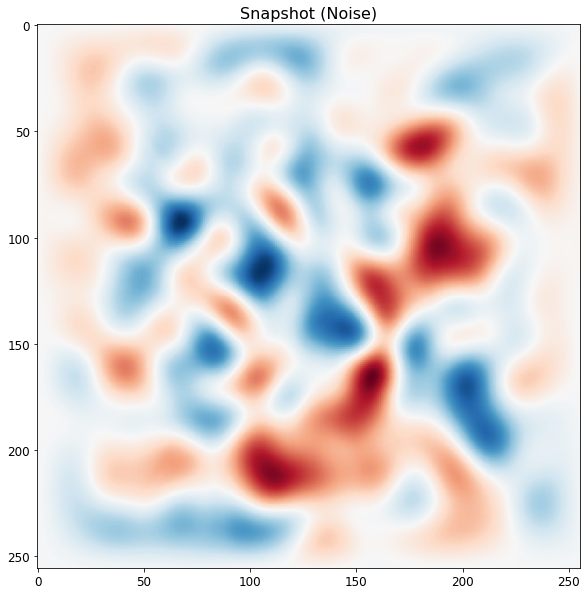

In [ ]:
noise = tf.random.normal([1, latent_space])
generated_image = generator(noise, training=False)
print(generated_image.shape)

fig, ax = plt.subplots(figsize=[10,10])
inv_generated_image = invert_data(generated_image[0, :, :, 0])
print(inv_generated_image.shape)
ax.imshow(inv_generated_image[0, :].reshape(nx, nx), cmap='RdBu');
ax.set_title('Snapshot (Noise)', fontsize=16);

Discriminator

In [ ]:
from tensorflow.keras import backend as K
from tensorflow.keras.layers import InputSpec, Layer
from tensorflow.keras import initializers, regularizers, constraints

class MinibatchDiscrimination(Layer):
  def __init__(self, nb_kernels, kernel_dim, init='glorot_uniform', weights=None,
                W_regularizer=None, activity_regularizer=None,
                W_constraint=None, input_dim=None, **kwargs):
      self.init = initializers.get(init)
      self.nb_kernels = nb_kernels
      self.kernel_dim = kernel_dim
      self.input_dim = input_dim

      self.W_regularizer = regularizers.get(W_regularizer)
      self.activity_regularizer = regularizers.get(activity_regularizer)

      self.W_constraint = constraints.get(W_constraint)

      self.initial_weights = weights
      self.input_spec = [InputSpec(ndim=2)]

      if self.input_dim:
          kwargs['input_shape'] = (self.input_dim,)
      super(MinibatchDiscrimination, self).__init__(**kwargs)

  def build(self, input_shape):
      assert len(input_shape) == 2

      input_dim = input_shape[1]
      self.input_spec = [InputSpec(dtype=K.floatx(),
                                    shape=(None, input_dim))]

      self.W = self.add_weight(shape=(self.nb_kernels, input_dim, self.kernel_dim),
          initializer=self.init,
          name='kernel',
          regularizer=self.W_regularizer,
          trainable=True,
          constraint=self.W_constraint)

      # Set built to true.
      super(MinibatchDiscrimination, self).build(input_shape)

  def call(self, x, mask=None):
      activation = K.reshape(K.dot(x, self.W), (-1, self.nb_kernels, self.kernel_dim))
      diffs = K.expand_dims(activation, 3) - K.expand_dims(K.permute_dimensions(activation, [1, 2, 0]), 0)
      #in_shape = tf.Variable(BATCH_SIZE)
      abs_diffs = K.sum(K.abs(diffs), axis=2)
      if x.shape[0] != None:
        abs_diffs += 1e6*K.expand_dims(K.eye(x.shape[0]), 1)
      minibatch_features = K.sum(K.exp(-abs_diffs), axis=2)
      return K.concatenate([x, minibatch_features], 1)

  def compute_output_shape(self, input_shape):
      assert input_shape and len(input_shape) == 2
      return input_shape[0], input_shape[1]+self.nb_kernels

  def get_config(self):
      config = {'nb_kernels': self.nb_kernels,
                  'kernel_dim': self.kernel_dim,
                  'init': self.__init__.__name__,
                  'W_regularizer': self.W_regularizer.get_config() if self.W_regularizer else None,
                  'activity_regularizer': self.activity_regularizer.get_config() if self.activity_regularizer else None,
                  'W_constraint': self.W_constraint.get_config() if self.W_constraint else None,
                  'input_dim': self.input_dim}
      base_config = super(MinibatchDiscrimination, self).get_config()
      return dict(list(base_config.items()) + list(config.items()))

In [ ]:

def make_discriminator_model():
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.Conv2D(64, (3, 3), strides=(2, 2), padding='same',
                                     input_shape=[ntimes, num_of_coeff, 1]))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(256, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(256, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Flatten())
    
    minibatch_layer = MinibatchDiscrimination(nb_kernels=100, kernel_dim=5)
    model.add(minibatch_layer)
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))
    

    model.add(tf.keras.layers.Dense(1))

    return model
discriminator = make_discriminator_model()
discriminator.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 4, 146, 64)        640       
_________________________________________________________________
leaky_re_lu_10 (LeakyReLU)   (None, 4, 146, 64)        0         
_________________________________________________________________
dropout (Dropout)            (None, 4, 146, 64)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 2, 73, 64)         102464    
_________________________________________________________________
leaky_re_lu_11 (LeakyReLU)   (None, 2, 73, 64)         0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 2, 73, 64)         0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 1, 37, 128)       

Test disciriminator model

In [ ]:
decision = discriminator(generated_image)
print(decision)

tf.Tensor([[4.1999723e-05]], shape=(1, 1), dtype=float32)


Generative Model


In [ ]:
gan = tf.keras.models.Sequential ([generator, discriminator])

Cost Function and Optimization

In [ ]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def log_sum_exp(x, axis=1):
  m = tf.math.reduce_max(x, axis=axis)
  return m + tf.math.log(tf.math.reduce_sum(tf.math.exp(x - K.expand_dims(x, 1)), axis=axis))

def discriminator_loss(real_output, fake_output):
  real_loss = cross_entropy(tf.ones_like(real_output), real_output)
  fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
  total_loss = real_loss + fake_loss
  return total_loss

def generator_loss(fake_output):
  fake_loss = cross_entropy(tf.ones_like(fake_output), fake_output)
  return fake_loss

generator_mean_loss = tf.keras.metrics.Mean(dtype=tf.float32)
discriminator_mean_loss = tf.keras.metrics.Mean(dtype=tf.float32)


# Optimizers for generator and optimizer models
generator_optimizer = tf.keras.optimizers.Adam(learning_rate=g_lr, beta_1=0.,beta_2=0.9)
discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=d_lr, beta_1=0., beta_2=0.9)


In [ ]:
# logs to document losses
version_num = 'E3000_minibatch125' # no clipping, same LR
# generator_log_dir = SAVE_DIR + 'logs/generator_v' + str(version_num) + '_'+ str(num_of_coeff)
# discriminator_log_dir = SAVE_DIR + 'logs/discriminator_v' + str(version_num) + '_'+ str(num_of_coeff)
# gen_summary = tf.summary.create_file_writer(generator_log_dir)
# disc_summary = tf.summary.create_file_writer(discriminator_log_dir)


print('Version no.: ', version_num)
print('POD coeffiecients: ', num_of_coeff)
print('Batch size: ', BATCH_SIZE)
print('Learning Rate: ', g_lr, '(gen),', d_lr, '(disc)')
print('Instances: ', ntimes)
print('Time steps: ', step)

Version no.:  E3000_minibatch125
POD coeffiecients:  292
Batch size:  125
Learning Rate:  0.001 (gen), 0.0001 (disc)
Instances:  7
Time steps:  5


Training step

In [ ]:
def train_step(batch):
    noise = tf.random.normal([BATCH_SIZE, latent_space])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)
        real_output = discriminator(batch, training=True)
        fake_output = discriminator(generated_images, training=True)

        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
    
    generator_mean_loss(gen_loss)
    discriminator_mean_loss(disc_loss)

Train GAN - Training loop

In [ ]:
def train(dataset, epochs):
    hist = []
    for epoch in range(epochs+1):
        start = time.time()
        print("Epoch {}/{}".format(epoch + 1, epochs))   

        for batch in dataset:
            train_step(batch)
            
        # with gen_summary.as_default():
        #     tf.summary.scalar('loss', generator_mean_loss.result(), step=epoch)

        # with disc_summary.as_default():
        #     tf.summary.scalar('loss', discriminator_mean_loss.result(), step=epoch)
        
        hist.append([generator_mean_loss.result().numpy(), discriminator_mean_loss.result().numpy()])

        generator_mean_loss.reset_states()
        discriminator_mean_loss.reset_states()
        

        print("discriminator loss: ", "{:.6f}".format(hist[-1][1]), end=' - ')
        print("generator loss: ", "{:.6f}".format(hist[-1][0]), end=' - ')    
        print ('{:.0f}s'.format( time.time()-start))

        pred_time_len = 4
        # Global variables are used below
        if epoch%1000 == 0: 
            # Plot generated data
            X_generated = generator.predict(seed).reshape(-1, num_of_coeff)
            X_generated = invert_data(X_generated)
            print(X_generated.shape)
            X_generated = X_generated.reshape(num_examples_to_generate, ntimes, nx, nx)
            fig, ax = plt.subplots(5, pred_time_len, figsize=[20, 25], constrained_layout=True)
            for j in range(5):
              for i in range(pred_time_len):
                im = ax.flatten()[i + (pred_time_len*j)].imshow(X_generated[j][i,:,:], cmap='RdBu')
                ax[j,i].set_xticklabels([]), ax[j,i].set_yticklabels([])
              fig.colorbar(im, ax=ax[j,:], location='right', shrink=0.8, pad=0.05)
            plt.show()  
        
            # plot loss
            print('Loss: ')
            fig, ax = plt.subplots(1,1, figsize=[20,10])
            ax.plot(hist)
            ax.legend(['loss_gen', 'loss_disc'])
            ax.set_yscale('log')
            ax.grid()
            plt.show()
            
          # Save model once greater that 10,000 iterations 
            gan.save(SAVE_DIR + 'ganmodels/model_v'+ str(version_num) + '_'+ 
                                        str(num_of_coeff)+'_'+str(epoch)+'.h5')  
    return hist

In [ ]:
import time
hist = train(train_dataset, epochs=50000)

# Prediction with GAN

### Sample generation

In [ ]:
from tensorflow.keras import backend as K
from tensorflow.keras.layers import InputSpec, Layer
from tensorflow.keras import initializers, regularizers, constraints

class MinibatchDiscrimination(Layer):
  def __init__(self, nb_kernels, kernel_dim, init='glorot_uniform', weights=None,
                W_regularizer=None, activity_regularizer=None,
                W_constraint=None, input_dim=None, **kwargs):
      self.init = initializers.get(init)
      self.nb_kernels = nb_kernels
      self.kernel_dim = kernel_dim
      self.input_dim = input_dim

      self.W_regularizer = regularizers.get(W_regularizer)
      self.activity_regularizer = regularizers.get(activity_regularizer)

      self.W_constraint = constraints.get(W_constraint)

      self.initial_weights = weights
      self.input_spec = [InputSpec(ndim=2)]

      if self.input_dim:
          kwargs['input_shape'] = (self.input_dim,)
      super(MinibatchDiscrimination, self).__init__(**kwargs)

  def build(self, input_shape):
      assert len(input_shape) == 2

      input_dim = input_shape[1]
      self.input_spec = [InputSpec(dtype=K.floatx(),
                                    shape=(None, input_dim))]

      self.W = self.add_weight(shape=(self.nb_kernels, input_dim, self.kernel_dim),
          initializer=self.init,
          name='kernel',
          regularizer=self.W_regularizer,
          trainable=True,
          constraint=self.W_constraint)

      # Set built to true.
      super(MinibatchDiscrimination, self).build(input_shape)

  def call(self, x, mask=None):
      activation = K.reshape(K.dot(x, self.W), (-1, self.nb_kernels, self.kernel_dim))
      diffs = K.expand_dims(activation, 3) - K.expand_dims(K.permute_dimensions(activation, [1, 2, 0]), 0)
      #in_shape = tf.Variable(BATCH_SIZE)
      abs_diffs = K.sum(K.abs(diffs), axis=2)
      if x.shape[0] != None:
        abs_diffs += 1e6*K.expand_dims(K.eye(x.shape[0]), 1)
      minibatch_features = K.sum(K.exp(-abs_diffs), axis=2)
      return K.concatenate([x, minibatch_features], 1)

  def compute_output_shape(self, input_shape):
      assert input_shape and len(input_shape) == 2
      return input_shape[0], input_shape[1]+self.nb_kernels

  def get_config(self):
      config = {'nb_kernels': self.nb_kernels,
                  'kernel_dim': self.kernel_dim,
                  'init': self.__init__.__name__,
                  'W_regularizer': self.W_regularizer.get_config() if self.W_regularizer else None,
                  'activity_regularizer': self.activity_regularizer.get_config() if self.activity_regularizer else None,
                  'W_constraint': self.W_constraint.get_config() if self.W_constraint else None,
                  'input_dim': self.input_dim}
      base_config = super(MinibatchDiscrimination, self).get_config()
      return dict(list(base_config.items()) + list(config.items()))

In [ ]:
# loading modesl with custom layers
from tensorflow.keras.models import load_model
from tensorflow.python.keras.initializers import glorot_uniform
model_dir = 'ganmodels/model_vE3000_minibatch1_292_5000.h5'
custom_objects={'MinibatchDiscrimination': MinibatchDiscrimination, '__init__':glorot_uniform()}
with tf.keras.utils.custom_object_scope(custom_objects):
  generator, discriminator = load_model(SAVE_DIR + model_dir).layers

np.random.seed(99)
tf.random.set_seed(99)


(28, 65536)


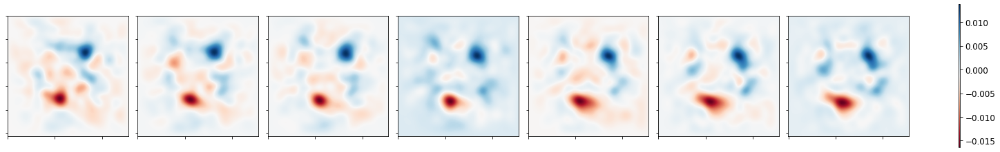

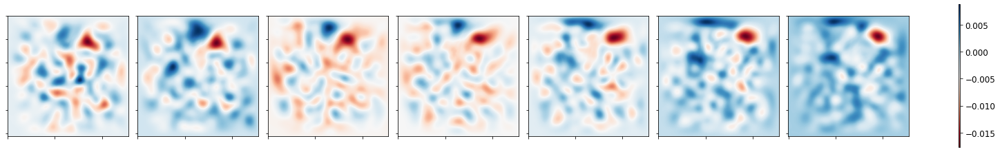

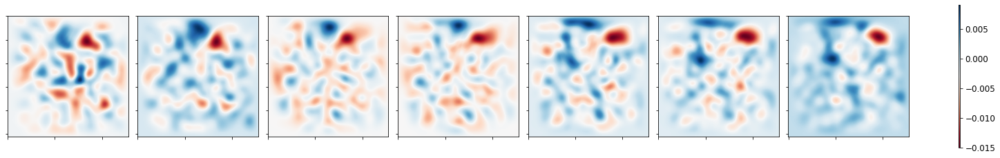

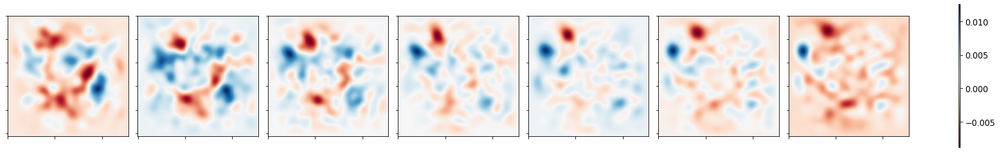

In [ ]:

npredict = 4
latent_size = 3000
pred_time_len = 7
ntimes = 7
noise = tf.random.normal(shape=[npredict, latent_size])
X_generated = generator.predict(noise).reshape(-1, num_of_coeff)
X_generated = invert_data(X_generated)
print(X_generated.shape)
X_generated = X_generated.reshape(npredict, ntimes, nx, nx)

for j in range(npredict):
  fig, ax = plt.subplots(1, pred_time_len, figsize=[20, 16], constrained_layout=True)
  for i in range(pred_time_len):
    im = ax.flatten()[i].imshow(X_generated[j][i,:,:], cmap='RdBu')
    ax[i].set_xticklabels([]), ax[i].set_yticklabels([])
  fig.colorbar(im, ax=ax[:], location='right', shrink=0.18, pad=0.05)
  plt.show() 


### Number of Statistically Different Bins (NDB score) 

Mode collapse test based on [2018 paper by Richardson and Weiss](https://arxiv.org/abs/1805.12462)

Steps:
1. Use K-means clustering to divide the training samples into K diffrenet bins.

2. Take the test samples and allocate into the closest bins (based on L2 distance from one of the K centroids).

3. For each bin, condduct a 2-sample test between trainig and test data to obtain a z-score. If this score is smaller than a set threshold value, then mark bin as statistically different.

4. Coun total number of statisticaly different bins and divide by K to get NDB score.

In [ ]:
discriminator.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 6, 146, 64)        640       
_________________________________________________________________
leaky_re_lu_10 (LeakyReLU)   (None, 6, 146, 64)        0         
_________________________________________________________________
dropout (Dropout)            (None, 6, 146, 64)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 3, 73, 64)         102464    
_________________________________________________________________
leaky_re_lu_11 (LeakyReLU)   (None, 3, 73, 64)         0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 3, 73, 64)         0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 2, 37, 64)        

In [ ]:
generator.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 30720)             61440000  
_________________________________________________________________
batch_normalization_5 (Batch (None, 30720)             122880    
_________________________________________________________________
leaky_re_lu_5 (LeakyReLU)    (None, 30720)             0         
_________________________________________________________________
reshape_1 (Reshape)          (None, 5, 12, 512)        0         
_________________________________________________________________
conv2d_transpose_5 (Conv2DTr (None, 5, 12, 256)        2752512   
_________________________________________________________________
batch_normalization_6 (Batch (None, 5, 12, 256)        1024      
_________________________________________________________________
leaky_re_lu_6 (LeakyReLU)    (None, 5, 12, 256)       

### Predict a point in time 

In [ ]:
weight = tf.constant(pca.singular_values_, dtype=tf.float32)
weight.shape

TensorShape([292])

In [ ]:
codings_size = num_of_coeff
mse = tf.keras.losses.MeanSquaredError()
mae = tf.keras.losses.MeanAbsoluteError()
optimizer = tf.keras.optimizers.Adam(2e-4)

def mse_loss(inp, outp, loss_weight):
    inp = tf.reshape(inp, [-1, codings_size]) #*tf.math.sqrt(loss_weight)
    outp = tf.reshape(outp, [-1, codings_size]) # *tf.math.sqrt(loss_weight)
    return mse(inp, outp)

def mae_loss(inp, outp, loss_weight):
    inp = tf.reshape(inp, [-1, codings_size])*loss_weight
    outp = tf.reshape(outp, [-1, codings_size])*loss_weight
    return mae(inp, outp)

In [ ]:
@tf.function
def opt_step(latent_values, real_coding, loss_weight):
    with tf.GradientTape() as tape:
        tape.watch(latent_values)
        gen_output = generator(latent_values, training=False)  #results from generator
        loss = mae_loss(real_coding, gen_output[:,:(ntimes - 1),:,:], loss_weight)   
        #codings_size is size of each output, ntimes is number of time levels. 
        #If training for 9 time levels, it finds the loss between the first 8 outputs from the generator and 8 real outputs

    gradient = tape.gradient(loss, latent_values)   #gradient of the loss ws to the input
    optimizer.apply_gradients(zip([gradient], [latent_values]))   #applies gradients to the input
    
    return loss

In [ ]:
def optimize_coding(real_coding, loss_weight, opt_epochs):
    latent_values = tf.random.normal([len(real_coding), latent_size])  
    latent_values = tf.Variable(latent_values)     #make input a tensorflow variable so it can be trained
    
    loss = []
    step_loss = 1
    opt_num = 0
    # while step_loss > 0.05:
    for epoch in range(opt_epochs):
        step_loss = opt_step(latent_values, real_coding, loss_weight).numpy()
        loss.append(step_loss)
        opt_num += 1
        
    plt.plot(loss)
    plt.grid()
    plt.show
        
    return latent_values, opt_num  #returns the optimized input that generates the desired output

(2000, 2044)
(1, 2044)
(1, 1752)
MSE Loss:  0.0058178175
MAE Loss:  0.109529085
150000


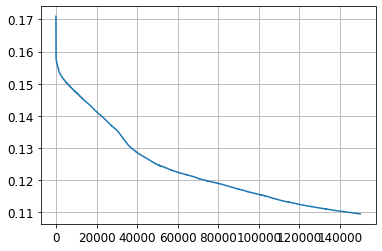

In [ ]:
n = 500 # arbitrary sample
opt_epochs = 150000
print(X_train_concat_flatten.shape)
real_coding = X_train_concat_flatten[n].reshape(1,-1)
print(real_coding.shape)
real_coding = real_coding[:,:codings_size*(ntimes - 1)]
print(real_coding.shape)
real_coding = tf.constant(real_coding)  
real_coding = tf.cast(real_coding, dtype=tf.float32)
latent_values, opt_num = optimize_coding(real_coding, weight, opt_epochs)
print('MSE Loss: ', mse_loss(generator(latent_values)[:,:(ntimes - 1),:,:], real_coding, weight).numpy())
print('MAE Loss: ', mae_loss(generator(latent_values)[:,:(ntimes - 1),:,:], real_coding, weight).numpy())
print(opt_num)
# print(latent_values)

In [ ]:
X_gen = generator.predict(np.asarray(latent_values)).reshape(ntimes, codings_size)
X_gen = invert_data(X_gen)
print(X_gen.shape)
X_gen = X_gen.reshape(ntimes, nx*nx)

(7, 65536)


In [ ]:
X_real = X_train_concat_flatten[10].reshape(ntimes,codings_size)
print(X_train_concat_flatten.shape)
X_real = invert_data(X_real)
print(X_real.shape)
X_real = X_real.reshape(ntimes, nx*nx)

(2000, 2044)
(7, 65536)


**Generated Data**

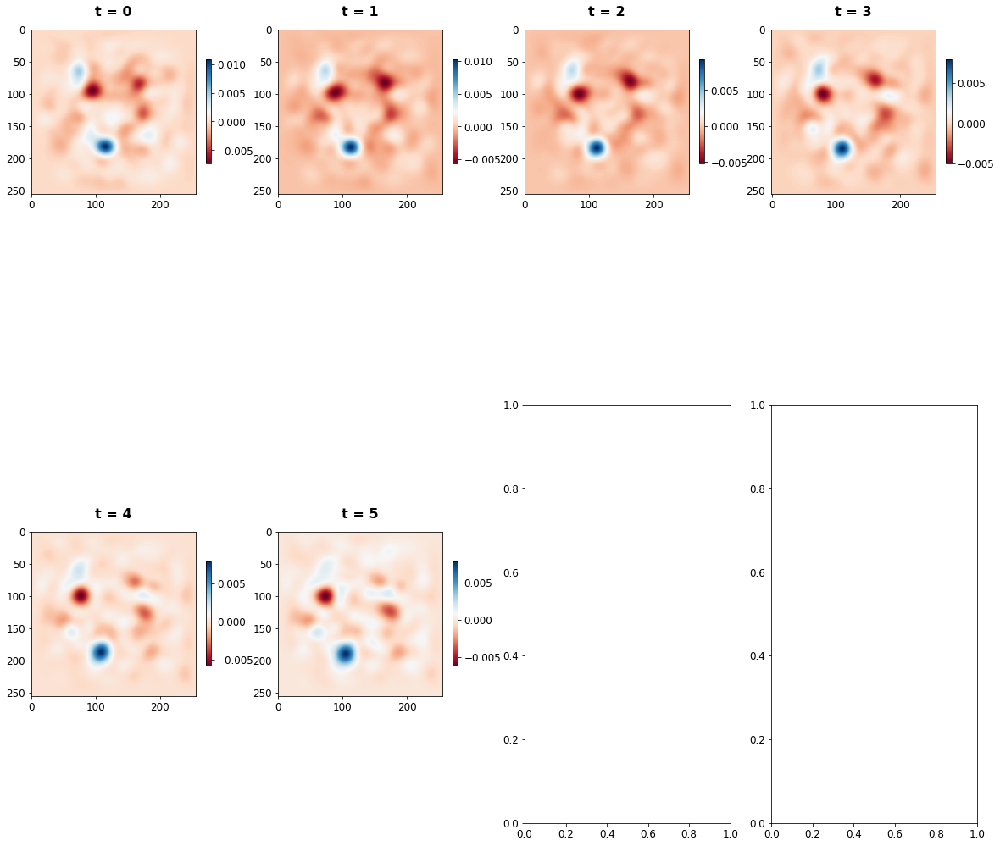

In [ ]:
times = [i for i in range(ntimes-1)]
plot_vortex(X_gen.reshape(ntimes, nx, nx), times, 4, 2)

**Real Data**

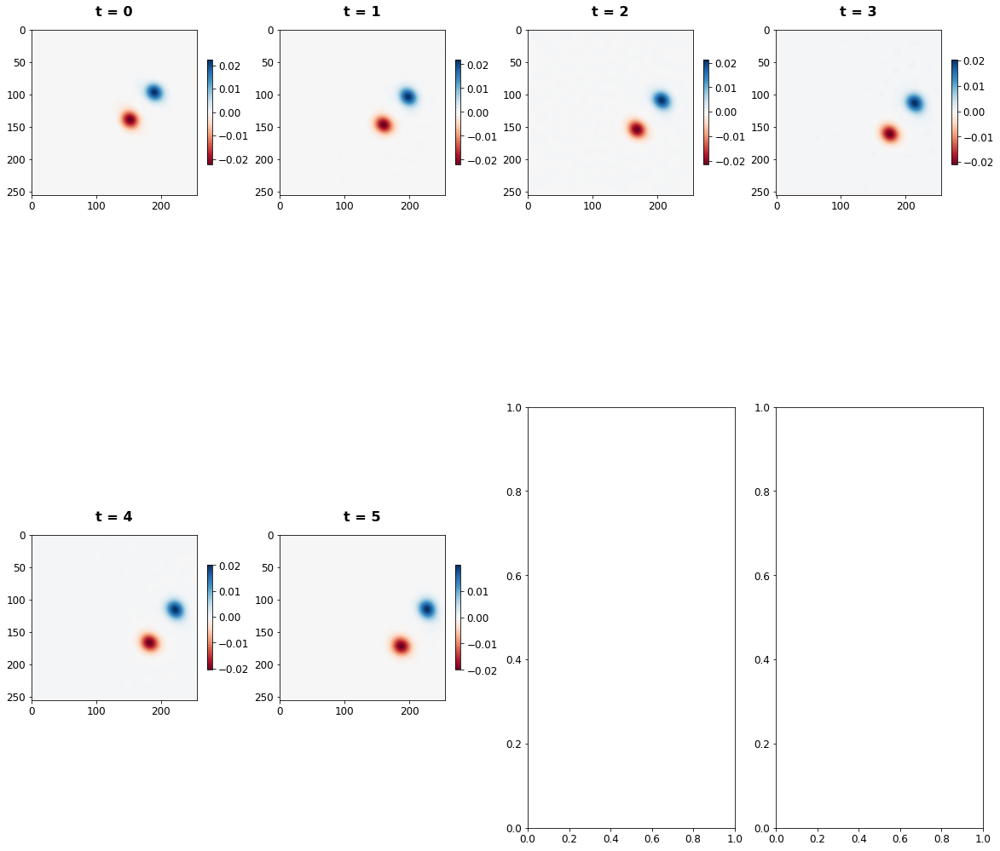

In [ ]:
plot_vortex(X_real.reshape(ntimes, nx, nx), times, 4, 2)

**Comparing Predicted and Real Data for 20th timestep**

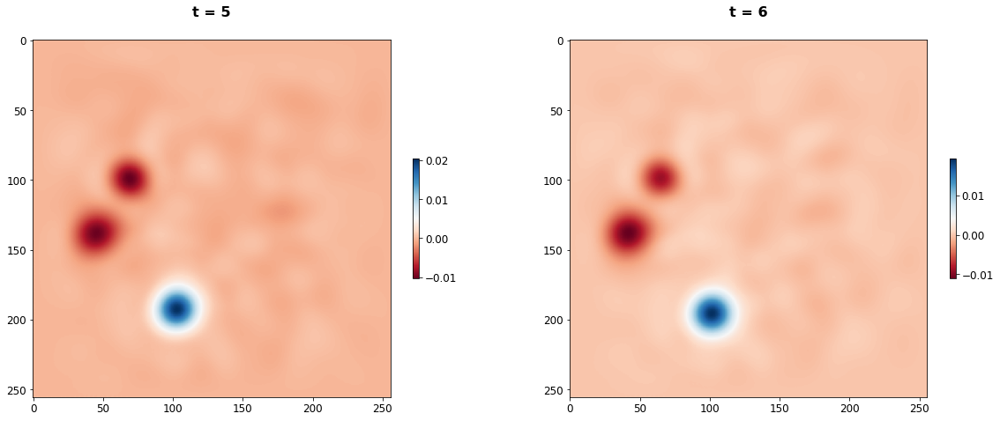

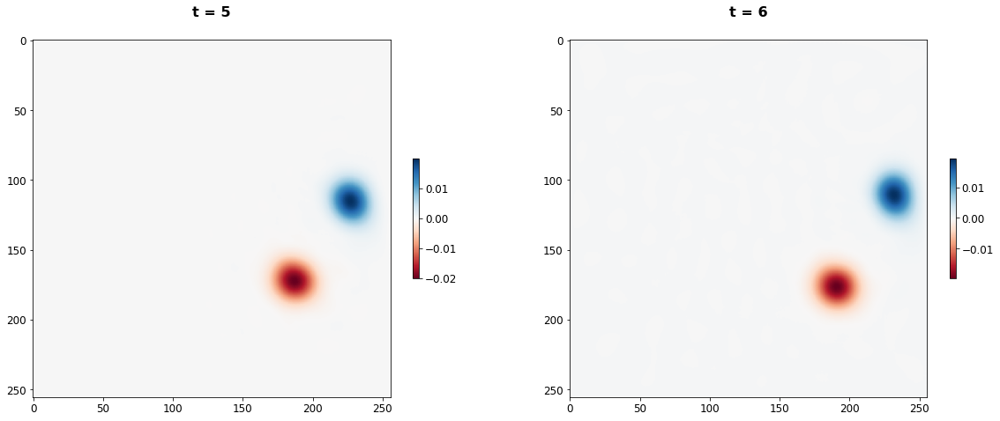

In [ ]:
plot_vortex(X_gen.reshape(ntimes, nx, nx), [ntimes-2, ntimes-1], 2)
plot_vortex(X_real.reshape(ntimes, nx, nx), [ntimes-2, ntimes-1],2)

In [ ]:
real = X_real.reshape(ntimes, nx, nx)
generated = X_gen.reshape(ntimes, nx, nx)
X_diff = real - generated
print('Mean Error: ', np.mean(X_diff))
print('Max. Error: ', np.max(X_diff))
plot_vortex(X_diff, times, 4, 2)

In [ ]:
discriminator.get_config()

{'layers': [{'class_name': 'InputLayer',
   'config': {'batch_input_shape': (None, 7, 292, 1),
    'dtype': 'float32',
    'name': 'conv2d_input',
    'ragged': False,
    'sparse': False}},
  {'class_name': 'Conv2D',
   'config': {'activation': 'linear',
    'activity_regularizer': None,
    'batch_input_shape': (None, 7, 292, 1),
    'bias_constraint': None,
    'bias_initializer': {'class_name': 'Zeros', 'config': {}},
    'bias_regularizer': None,
    'data_format': 'channels_last',
    'dilation_rate': (1, 1),
    'dtype': 'float32',
    'filters': 64,
    'groups': 1,
    'kernel_constraint': None,
    'kernel_initializer': {'class_name': 'GlorotUniform',
     'config': {'seed': None}},
    'kernel_regularizer': None,
    'kernel_size': (3, 3),
    'name': 'conv2d',
    'padding': 'same',
    'strides': (2, 2),
    'trainable': True,
    'use_bias': True}},
  {'class_name': 'LeakyReLU',
   'config': {'alpha': 0.30000001192092896,
    'dtype': 'float32',
    'name': 'leaky_re_lu_1

In [ ]:
generator.get_config()

{'layers': [{'class_name': 'InputLayer',
   'config': {'batch_input_shape': (None, 3000),
    'dtype': 'float32',
    'name': 'dense_1_input',
    'ragged': False,
    'sparse': False}},
  {'class_name': 'Dense',
   'config': {'activation': 'linear',
    'activity_regularizer': None,
    'batch_input_shape': (None, 3000),
    'bias_constraint': None,
    'bias_initializer': {'class_name': 'Zeros', 'config': {}},
    'bias_regularizer': None,
    'dtype': 'float32',
    'kernel_constraint': None,
    'kernel_initializer': {'class_name': 'GlorotUniform',
     'config': {'seed': None}},
    'kernel_regularizer': None,
    'name': 'dense_1',
    'trainable': True,
    'units': 30720,
    'use_bias': False}},
  {'class_name': 'BatchNormalization',
   'config': {'axis': ListWrapper([1]),
    'beta_constraint': None,
    'beta_initializer': {'class_name': 'Zeros', 'config': {}},
    'beta_regularizer': None,
    'center': True,
    'dtype': 'float32',
    'epsilon': 0.001,
    'gamma_constrai